# Задача: Тестовое задание на позицию Data Scientist.

# Содержание
* [Импорт библиотек](#импорт-библиотек)
* [Загрузка и первичный анализ данных](#загрузка-и-первичный-анализ-данных)
* [Ответы на вопросы](#ответы-на-вопросы)
    * [Вопрос 1. Интерпретация переменных](#1-интерпретируйте-названия-переменных-какие-вредные-вещества-и-примеси-охватывал-проводившийся-мониторинг)
    * [Вопрос 2. Выбросы](#2-существуют-ли-в-представленных-данных-выбросы-если-таковые-есть-каким-образом-будете-от-них-избавляться)
    * [Вопрос 3. Корреляция между переменными](#3-существуют-ли-корреляционные-связи-между-представленными-переменными-если-такие-связи-есть-насколько-они-сильны)
    * [Вопросы 4, 4*, 4**, 5, 5*. Создание моделей классификации, описание алгоритмов, подбор гиперпараметров, расчет метрик, интерпретация моделей](#4-создайте-классификационную-модель-которая-по-составу-атмосферного-воздуха-сможет-предсказать-в-каком-районе-вы-находитесь-в-ходе-создания-попробуйте-несколько-методов-классификации)
        * [Логистическая регрессия](#1-логистическая-регрессия)
        * [Случайный лес](#2-случайный-лес-random-forest)
        * [Метод опорных векторов](#3-метод-опорных-векторов-svm)
        * [Градиентный бустинг](#4-градиентный-бустинг-gradient-boosting)
        * [Выводы о работе четырех моделей](#выводы-о-работе-четырех-моделей)
    * [Вопрос 5. Метамоделирование](#5-попробуйте-применить-метамоделирование-каким-образом-вы-его-реализовали-и-смогли-ли-вы-улучшить-показатели-качества-классификации)
    * [Вопрос 6. Проверка схожести характеристик близко расположенных станций](#6-проверьте-предположение-о-том-что-если-станции-наблюдения-расположены-относительно-недалеко-друг-от-друга-то-они-регистрируют-в-целом-схожие-характеристики-загрязнения-атмосферы)
    * [Вопрос 7. Влияние сезонности на степень загрязнения воздуха](#7-изменяется-ли-степень-загрязнения-атмосферы-в-зависимости-от-времени-года-а-если-изменяется-то-насколько-существенно-и-в-каких-районах-может-ли-качество-модели-быть-улучшено-если-ко-входящим-переменным-добавить-день-или-месяц-наблюдения-каким-образом-вы-реализуете-введение-новой-переменной-в-модель)


## Импорт библиотек

In [241]:
import json
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import shap

from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (accuracy_score, confusion_matrix, classification_report,
                             ConfusionMatrixDisplay, roc_curve, auc, roc_auc_score)
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.inspection import PartialDependenceDisplay

import folium
from folium import Marker, Choropleth
from IPython.display import display, Markdown
from branca.colormap import linear


# Загрузка и первичный анализ данных

Загрузим данные из csv-файлов:

In [3]:
eco = pd.read_csv('data/AerialEcoData_Seoul.csv')
coords = pd.read_csv('data/Station_coordinates.csv')

Посмотрим основные характеристики данных в таблице AerialEcoData_Seoul.csv (суточные медианные значения показателей загрязнения атмосферы):

In [4]:
eco.head()

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.002,1.0,69.0,85.0
1,2017-01-01,104,0.006,0.0420,0.007,0.7,45.0,70.0
2,2017-01-01,106,0.005,0.0550,0.003,1.1,67.5,78.0
3,2017-01-01,112,0.005,0.0440,0.002,0.9,69.0,82.0
4,2017-01-01,116,0.006,0.0515,0.002,1.0,56.5,73.0


In [5]:
eco.shape

(2190, 8)

In [6]:
eco.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2190 entries, 0 to 2189
Data columns (total 8 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   Measurement_date  2190 non-null   object 
 1   Station_code      2190 non-null   int64  
 2   SO2               2190 non-null   float64
 3   NO2               2190 non-null   float64
 4   O3                2190 non-null   float64
 5   CO                2190 non-null   float64
 6   PM2_5             2190 non-null   float64
 7   PM10              2190 non-null   float64
dtypes: float64(6), int64(1), object(1)
memory usage: 137.0+ KB


In [7]:
eco.describe()

,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
count,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000
mean,109.333333,0.002430,0.024446,0.022786,0.504041,23.228539,43.466667
std,6.047500,0.047992,0.050739,0.051051,0.216488,14.653004,99.099759
min,101.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,104.000000,0.003000,0.017000,0.014500,0.400000,13.000000,25.000000
50%,109.000000,0.005000,0.024000,0.024000,0.500000,20.000000,36.250000
75%,116.000000,0.006000,0.034000,0.034500,0.600000,29.500000,51.500000
max,117.000000,0.012000,0.083500,0.086500,2.000000,104.000000,3363.000000


In [8]:
eco['Station_code'].value_counts()

Station_code
101    365
104    365
106    365
112    365
116    365
117    365
Name: count, dtype: int64

Сразу переведем значения в колонке 'Measurement_date' в формат datetime:

In [9]:
eco['Measurement_date'] = pd.to_datetime(eco['Measurement_date'])

Посмотрим основные характеристики данных в таблице Station_coordinates.csv (географические координаты станций наблюдения, районы их расположения):

In [10]:
coords.head()

,Address,Station code,Latitude,Longitude
0,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",101,37.572016,127.005008
1,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",102,37.564263,126.974676
2,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",103,37.540033,127.004850
3,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",104,37.609823,126.934848
4,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",105,37.593742,126.949679


In [11]:
coords.shape

(25, 4)

In [12]:
coords.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25 entries, 0 to 24
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   Address       25 non-null     object 
 1   Station code  25 non-null     int64  
 2   Latitude      25 non-null     float64
 3   Longitude     25 non-null     float64
dtypes: float64(2), int64(1), object(1)
memory usage: 928.0+ bytes


In [13]:
coords.describe()

,Station code,Latitude,Longitude
count,25.000000,25.000000,25.000000
mean,113.000000,37.553486,126.989339
std,7.359801,0.054373,0.080413
min,101.000000,37.452357,126.835151
25%,107.000000,37.517528,126.927102
50%,113.000000,37.544962,127.004850
75%,119.000000,37.584848,127.047470
max,125.000000,37.658774,127.136792


In [14]:
coords['Station code'].unique()

array([101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113,
       114, 115, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125])

## Ответы на вопросы

### 1. Интерпретируйте названия переменных. Какие вредные вещества и примеси охватывал проводившийся мониторинг?

In [15]:
eco.columns

Index(['Measurement_date', 'Station_code', 'SO2', 'NO2', 'O3', 'CO', 'PM2_5',
       'PM10'],
      dtype='object')

In [16]:
coords.columns

Index(['Address', 'Station code', 'Latitude', 'Longitude'], dtype='object')

Таблица AerialEcoData_Seoul.csv содержит следующие переменные:

1. Measurement_date - дата проведения измерения загрязнения воздуха;
2. Station_code - уникальный код, идентифицирующий станцию мониторинга, где было произведено измерение;
3. SO2 - концентрация диоксида серы (SO2) в воздухе, ppm;
4. NO2 - концентрация диоксида азота (NO2) в воздухе, ppm;
5. O3 - концентрация озона (O3) в воздухе, ppm;
6. CO - концентрация угарного газа (CO) в воздухе, ppm;
7. PM2_5 - концентрация в воздухе мелкодисперсных частиц (диаметр ≤ 2.5 мкм), мкг/м3;
8. PM10 - концентрация в воздухе крупнодисперсных частиц (диаметр ≤ 10 мкм)б мкг/м3.

Таблица Station_coordinates.csv содержит следующие переменные:

1. Address - адрес станции мониторинга в Сеуле;
2. Station code - уникальный код, идентифицирующий станцию мониторинга;
3. Latitude - географическая широта станции мониторинга;
4. Longitude - географическая долгота станции мониторинга.

Таким образом, проводившийся мониторинг охватывал следующие вредные вещества и примеси: диоксид серы, диоксид азота, озон, угарный газ, мелкодисперсные частицы диаметром до 2.5 мкм (PM2.5), крупнодисперсные частицы диаметром до 10 мкм (PM10).

### 2. Существуют ли в представленных данных выбросы? Если таковые есть, каким образом будете от них избавляться?

Посмотрим еще раз на характеристики каждой переменной в таблицах eco и coords:

In [17]:
eco.describe()

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
count,2190,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000,2190.000000
mean,2017-07-02 00:00:00,109.333333,0.002430,0.024446,0.022786,0.504041,23.228539,43.466667
min,2017-01-01 00:00:00,101.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000,-1.000000
25%,2017-04-02 00:00:00,104.000000,0.003000,0.017000,0.014500,0.400000,13.000000,25.000000
50%,2017-07-02 00:00:00,109.000000,0.005000,0.024000,0.024000,0.500000,20.000000,36.250000
75%,2017-10-01 00:00:00,116.000000,0.006000,0.034000,0.034500,0.600000,29.500000,51.500000
max,2017-12-31 00:00:00,117.000000,0.012000,0.083500,0.086500,2.000000,104.000000,3363.000000
std,NaN,6.047500,0.047992,0.050739,0.051051,0.216488,14.653004,99.099759


In [18]:
coords.describe()

,Station code,Latitude,Longitude
count,25.000000,25.000000,25.000000
mean,113.000000,37.553486,126.989339
std,7.359801,0.054373,0.080413
min,101.000000,37.452357,126.835151
25%,107.000000,37.517528,126.927102
50%,113.000000,37.544962,127.004850
75%,119.000000,37.584848,127.047470
max,125.000000,37.658774,127.136792


Видно, что в таблице coords все данные корректные. В таблице eco cразу бросается в глаза, что во всех переменных, характеризующих концентрации примесей, есть отрицательные значения (min = -1). Концентрация не может быть отрицательной, поэтому такие точки, вероятно, являются выбросами. Также интересно посмотреть на нулевые значения концентраций. Проверим, какие строки в таблице eco содержат отрицательные и нулевые значения концентраций примесей:

In [19]:
eco[eco['SO2'] <= 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
319,2017-02-23,104,0.0,0.0,0.0,0.0,0.0,0.0
398,2017-03-08,106,0.0,0.0,0.0,0.0,0.0,0.0
439,2017-03-15,104,0.0,0.0,0.0,0.0,0.0,0.0
811,2017-05-16,104,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
1575,2017-09-20,112,0.0,0.0,0.0,0.0,0.0,0.0
1715,2017-10-13,117,0.0,0.0,0.0,0.0,0.0,0.0
1798,2017-10-27,116,0.0,0.0,0.0,0.0,37.5,0.0
2098,2017-12-16,116,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2104,2017-12-17,116,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0
2110,2017-12-18,116,-1.0,-1.0,-1.0,-1.0,-1.0,-1.0


In [20]:
len(eco[eco['SO2'] <= 0])

20

Видно, что 20 строк в таблице eco содержат отрицательные или нулевые значения концентрации одновременно для всех примесей. Маловероятно, что в определенные дни измерений воздух был абсолютно чистым. Возможно, система мониторинга в эти дни не работала или имел место некий сбой в работе датчиков. Эти строки из таблицы можно удалить, так как они не содержат в себе корректной информации.

In [21]:
eco.drop(eco[eco['SO2'] <= 0].index, inplace=True)

Далее посмотрим на распределение данных для каждой переменной.

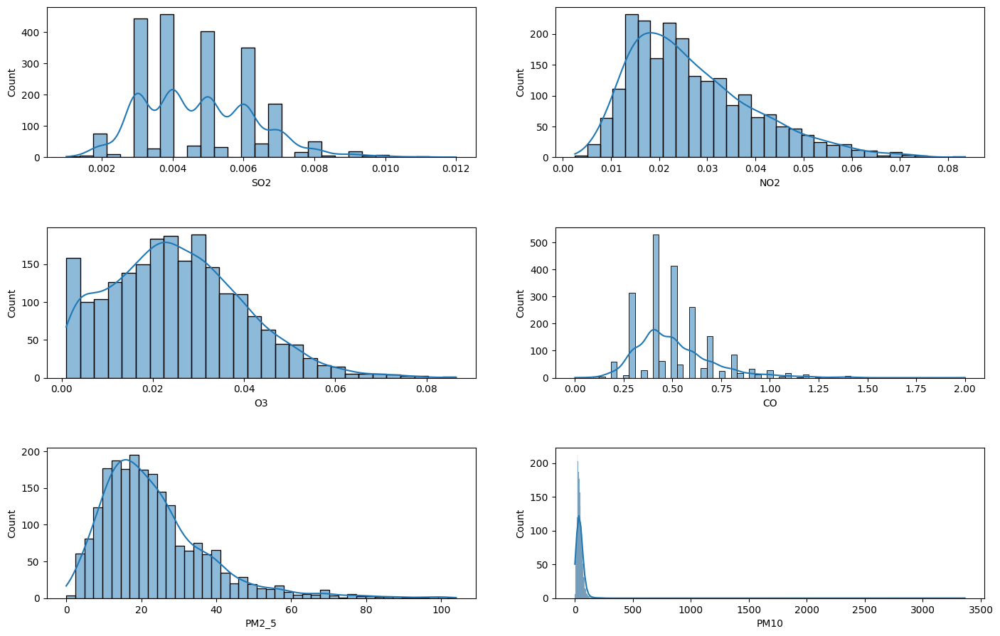

In [22]:
parameters = ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']

fig, axes = plt.subplots(3, 2, figsize=(15, 10))
fig.tight_layout(pad=5.0)

for param, ax in zip(parameters, axes.flatten()):
    sns.histplot(eco, x=param, kde=True, ax=ax)

Согласно приведенным выше графикам, форма распределений практически у всех признаков почти колоколообразная (нормальная), но смещена вправо. 

Также построим графики Box plot для всех признаков:

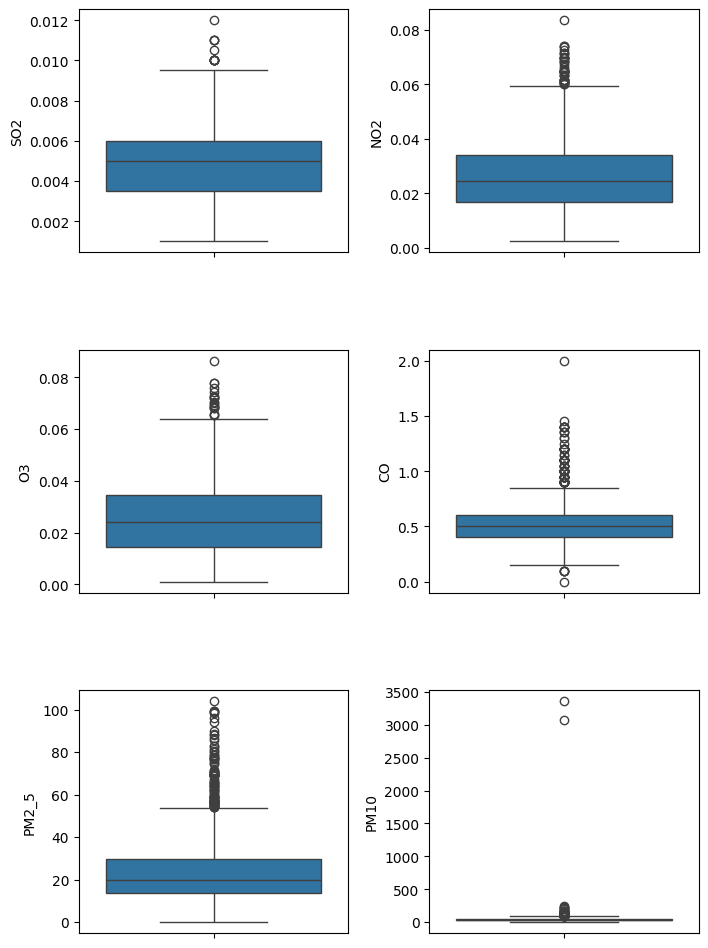

In [23]:
fig, axes = plt.subplots(3, 2, figsize=(8, 12))

plt.subplots_adjust(hspace=0.4, wspace=0.3)

for param, ax in zip(parameters, axes.flatten()):
    sns.boxplot(data=eco, y=param, ax=ax)

Посмотрим на 2 точки среди значений концентрации PM10, которые явно отличаются от остальных:

In [24]:
eco[eco['PM10'] > 1000]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
2182,2017-12-30,116,0.005,0.059,0.003,1.2,53.0,3068.5
2188,2017-12-31,116,0.003,0.025,0.019,0.5,14.5,3363.0


Оба измерения производились на одной и той же станции - 116.

In [25]:
eco[eco['Station_code'] == 116]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
4,2017-01-01,116,0.0060,0.0515,0.0020,1.00,56.5,73.0
10,2017-01-02,116,0.0065,0.0395,0.0085,0.65,64.5,93.5
16,2017-01-03,116,0.0070,0.0450,0.0110,0.70,50.0,77.5
22,2017-01-04,116,0.0070,0.0545,0.0020,0.70,35.0,64.5
28,2017-01-05,116,0.0060,0.0440,0.0035,0.70,30.0,58.0
...,...,...,...,...,...,...,...,...
2086,2017-12-14,116,0.0050,0.0585,0.0030,1.00,28.5,51.0
2092,2017-12-15,116,0.0045,0.0550,0.0020,1.35,41.5,56.5
2122,2017-12-20,116,0.0030,0.0435,0.0025,1.00,0.0,0.0
2182,2017-12-30,116,0.0050,0.0590,0.0030,1.20,53.0,3068.5


Посмотрим на значения для признака 'PM10' за текущий месяц измерений на станции 116.

In [27]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 12) & (eco['Station_code'] == 116)]

last_month

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
2008,2017-12-01,116,0.0050,0.0355,0.0205,0.45,12.0,23.5
2014,2017-12-02,116,0.0050,0.0540,0.0030,0.80,19.5,33.5
2020,2017-12-03,116,0.0050,0.0460,0.0045,0.70,28.5,37.5
2026,2017-12-04,116,0.0050,0.0165,0.0260,0.40,9.5,23.5
2032,2017-12-05,116,0.0050,0.0200,0.0230,0.40,9.0,17.5
2038,2017-12-06,116,0.0050,0.0410,0.0035,0.60,16.5,27.0
2044,2017-12-07,116,0.0050,0.0370,0.0110,0.65,26.5,37.0
2050,2017-12-08,116,0.0050,0.0220,0.0180,0.50,19.0,27.0
2056,2017-12-09,116,0.0055,0.0550,0.0020,0.90,21.0,34.0
2062,2017-12-10,116,0.0050,0.0395,0.0080,0.70,19.0,28.5


Можно заметить, что помимо двух последних строк, предшествующая им строка также выглядит подозрительно - концентрации PM2.5 и PM10 равны 0, что маловероятно для медианного суточного значения. В колонке 'PM10' заменим три последних значения концентрации на средние значения для данной станции в текущем месяце. Аналогично заменим на среднее нулевое значение в колонке 'PM2_5'.

In [28]:
mean_val = last_month.iloc[:-3]['PM10'].mean()

mean_val 

32.166666666666664

In [29]:
eco['PM10'] = eco.apply(lambda x: mean_val if x.name in [2122, 2182, 2188] else x['PM10'], axis=1)

In [30]:
mean_val = last_month.drop(2122)['PM2_5'].mean()

mean_val 

21.029411764705884

In [31]:
eco['PM2_5'] = eco.apply(lambda x: mean_val if x.name == 2122 else x['PM2_5'], axis=1)

Снова построим график Box plot для всех признаков:

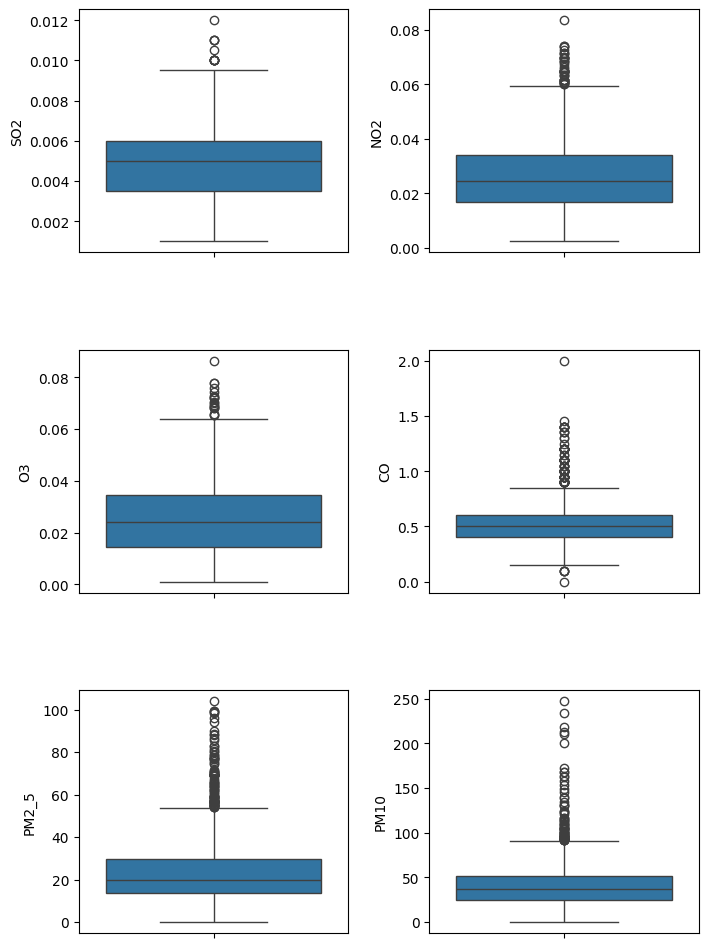

In [32]:
fig, axes = plt.subplots(3, 2, figsize=(8, 12))

plt.subplots_adjust(hspace=0.4, wspace=0.3)

for param, ax in zip(parameters, axes.flatten()):
    sns.boxplot(data=eco, y=param, ax=ax)

Построим также графики Scatter plot для всех признаков:

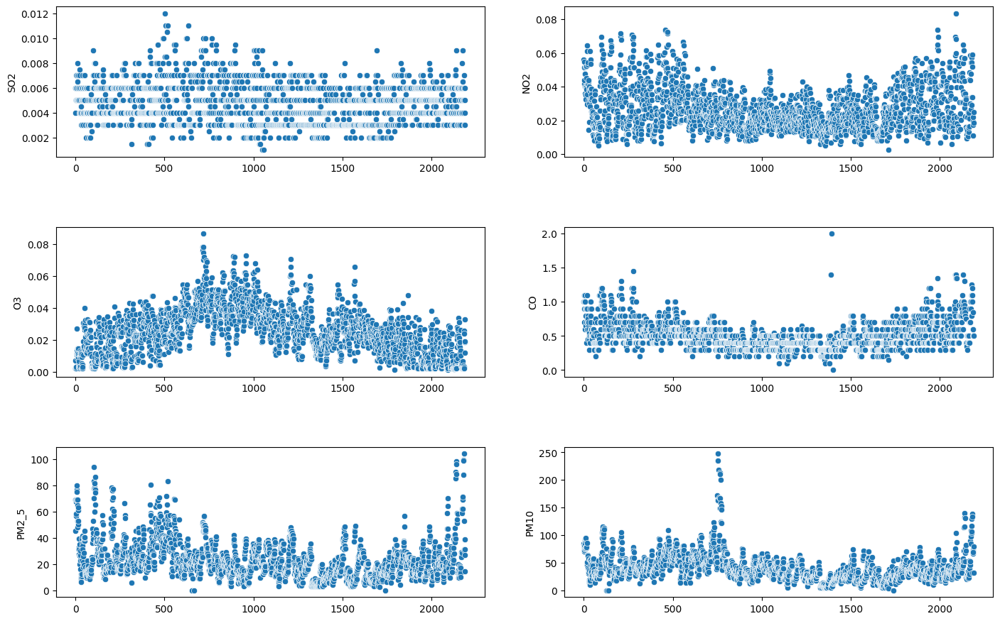

In [33]:
fig, axes = plt.subplots(3, 2, figsize=(15, 10))
fig.tight_layout(pad=5.0)

for param, ax in zip(parameters, axes.flatten()):
    sns.scatterplot(eco[param], ax=ax)

На графике для признака 'CO' явно выделяется одна верхняя точка, посмотрим на нее в таблице eco:

In [34]:
eco[eco['CO'] > 1.5]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
1393,2017-08-21,104,0.003,0.016,0.019,2.0,7.0,12.0


Посмотрим данные со станции 104 за август 2017 года:

In [35]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 8) & (eco['Station_code'] == 104)]

last_month

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
1273,2017-08-01,104,0.0040,0.0230,0.0290,0.20,10.0,20.5
1279,2017-08-02,104,0.0040,0.0135,0.0305,0.30,24.0,30.0
1285,2017-08-03,104,0.0040,0.0195,0.0235,0.50,16.5,23.0
1291,2017-08-04,104,0.0040,0.0175,0.0395,0.40,21.5,25.0
1297,2017-08-05,104,0.0030,0.0150,0.0365,0.40,19.5,22.5
1303,2017-08-06,104,0.0040,0.0130,0.0300,0.40,16.0,18.0
1309,2017-08-07,104,0.0030,0.0110,0.0540,0.40,23.5,30.5
1315,2017-08-08,104,0.0040,0.0165,0.0600,0.40,31.5,39.5
1321,2017-08-09,104,0.0035,0.0160,0.0400,0.40,25.0,31.0
1327,2017-08-10,104,0.0030,0.0120,0.0260,0.30,3.5,6.0


Видно, что значения для концентрации CO в воздухе 20 и 21 августа 2017 года в несколько раз отличались от средних значений за месяц (1.4 и 2.0 соответственно). Вероятно, эти две точки являются выбросами. Кроме того, 22 августа концентрация CO в воздухе была равна 0. Заменим эти три точки средними значениями для концентрации CO в этом месяце:

In [36]:
mean_val = last_month.drop([1387, 1393, 1399])['CO'].mean()

mean_val

0.3

Заменим значения-выбросы для 'CO' в таблице eco:

In [37]:
eco['CO'] = eco.apply(lambda x: mean_val if x.name in [1387, 1393, 1399] else x['CO'], axis=1)

Также проверим, остались ли еще нулевые значения для концентрации отдельных примесей в таблице eco, поскольку маловероятно, что суточные медианные значения концентрации действительно принимают значение 0:

In [38]:
params = ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']

for p in params:
    n = eco[eco[p] == 0]
    print(f'Нулевые значения для {p}')
    print(len(n))
    print()

Нулевые значения для SO2
0

Нулевые значения для NO2
0

Нулевые значения для O3
0

Нулевые значения для CO
0

Нулевые значения для PM2_5
3

Нулевые значения для PM10
4



Видно, что для PM2.5 и PM10 такие значения есть. Начнем с PM10:

In [39]:
eco[eco['PM10'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
124,2017-01-21,116,0.006,0.0435,0.0075,0.6,28.5,0.0
130,2017-01-22,116,0.007,0.0150,0.0300,0.4,22.0,0.0
136,2017-01-23,116,0.006,0.0230,0.0230,0.5,30.5,0.0
1740,2017-10-18,101,0.003,0.0325,0.0200,0.4,0.0,0.0


Заменим каждое из этих значений на среднее месячное значение для данной конкретной станции.

In [40]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 1) & (eco['Station_code'] == 116)]

last_month

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
4,2017-01-01,116,0.0060,0.0515,0.0020,1.00,56.5,73.0
10,2017-01-02,116,0.0065,0.0395,0.0085,0.65,64.5,93.5
16,2017-01-03,116,0.0070,0.0450,0.0110,0.70,50.0,77.5
22,2017-01-04,116,0.0070,0.0545,0.0020,0.70,35.0,64.5
28,2017-01-05,116,0.0060,0.0440,0.0035,0.70,30.0,58.0
34,2017-01-06,116,0.0050,0.0375,0.0090,0.40,10.5,16.0
40,2017-01-07,116,0.0070,0.0535,0.0020,0.80,34.0,55.5
46,2017-01-08,116,0.0060,0.0335,0.0150,0.50,28.5,41.5
52,2017-01-09,116,0.0070,0.0175,0.0300,0.50,40.0,56.0
58,2017-01-10,116,0.0060,0.0170,0.0255,0.30,14.0,38.5


In [41]:
mean_val = last_month.drop([124, 130, 136])['PM10'].mean()

mean_val

52.535714285714285

In [42]:
eco['PM10'] = eco.apply(lambda x: mean_val if x.name in [124, 130, 136] else x['PM10'], axis=1)

In [43]:
eco[eco['PM10'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
1740,2017-10-18,101,0.003,0.0325,0.02,0.4,0.0,0.0


In [44]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 10) & (eco['Station_code'] == 101)]

mean_val = last_month.drop(1740)['PM10'].mean()

eco['PM10'] = eco.apply(lambda x: mean_val if x.name == 1740 else x['PM10'], axis=1)

In [45]:
eco[eco['PM10'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10


Далее поработаем с нулевыми значениями концентрации PM2.5:

In [46]:
eco[eco['PM2_5'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
653,2017-04-19,117,0.006,0.0145,0.032,0.4,0.0,80.5
664,2017-04-21,116,0.008,0.0415,0.037,0.4,0.0,73.0
1740,2017-10-18,101,0.003,0.0325,0.020,0.4,0.0,26.7


In [47]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 4) & (eco['Station_code'] == 117)]

mean_val = last_month.drop(653)['PM2_5'].mean()

eco['PM2_5'] = eco.apply(lambda x: mean_val if x.name == 653 else x['PM2_5'], axis=1)

In [48]:
eco[eco['PM2_5'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
664,2017-04-21,116,0.008,0.0415,0.037,0.4,0.0,73.0
1740,2017-10-18,101,0.003,0.0325,0.020,0.4,0.0,26.7


In [49]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 4) & (eco['Station_code'] == 116)]

mean_val = last_month.drop(664)['PM2_5'].mean()

eco['PM2_5'] = eco.apply(lambda x: mean_val if x.name == 664 else x['PM2_5'], axis=1)

In [50]:
eco[eco['PM2_5'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
1740,2017-10-18,101,0.003,0.0325,0.02,0.4,0.0,26.7


In [51]:
last_month = eco[(eco['Measurement_date'].dt.year == 2017) & (eco['Measurement_date'].dt.month == 10) & (eco['Station_code'] == 101)]

mean_val = last_month.drop(1740)['PM2_5'].mean()

eco['PM2_5'] = eco.apply(lambda x: mean_val if x.name == 1740 else x['PM2_5'], axis=1)

In [52]:
eco[eco['PM2_5'] == 0]

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10


In [53]:
params = ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']

for p in params:
    n = eco[eco[p] == 0]
    print(f'Нулевые значения для {p}')
    print(len(n))
    print()

Нулевые значения для SO2
0

Нулевые значения для NO2
0

Нулевые значения для O3
0

Нулевые значения для CO
0

Нулевые значения для PM2_5
0

Нулевые значения для PM10
0



Таким образом, мы избавились от некорретных нулевых значений в данных.

Посмотрим на обновленные графики Box plot и Scatter plot для всех признаков:

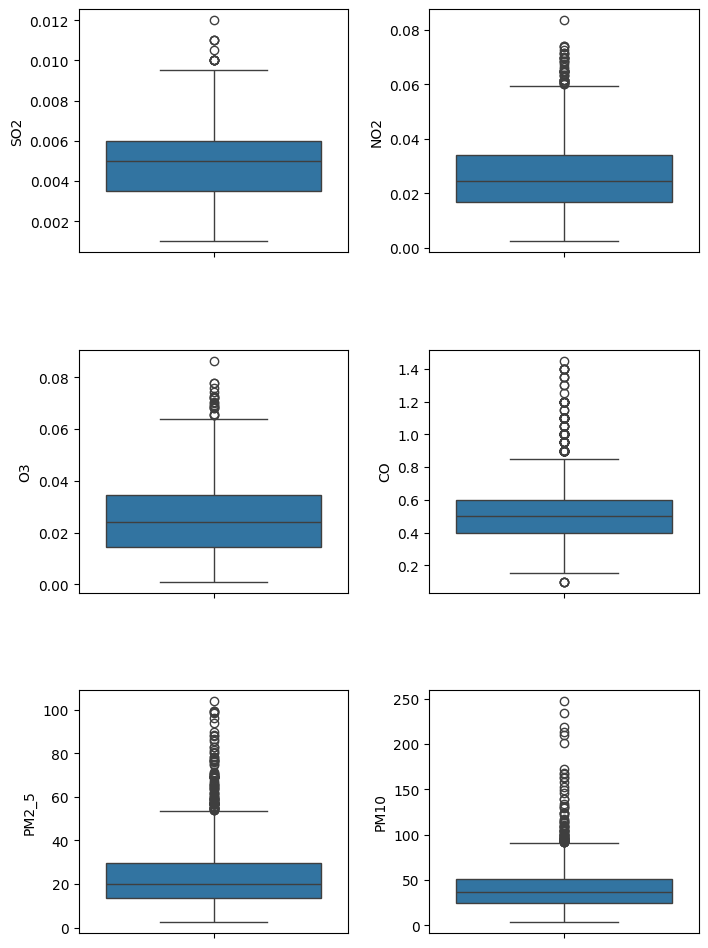

In [54]:
fig, axes = plt.subplots(3, 2, figsize=(8, 12))

plt.subplots_adjust(hspace=0.4, wspace=0.3)

for param, ax in zip(parameters, axes.flatten()):
    sns.boxplot(data=eco, y=param, ax=ax)

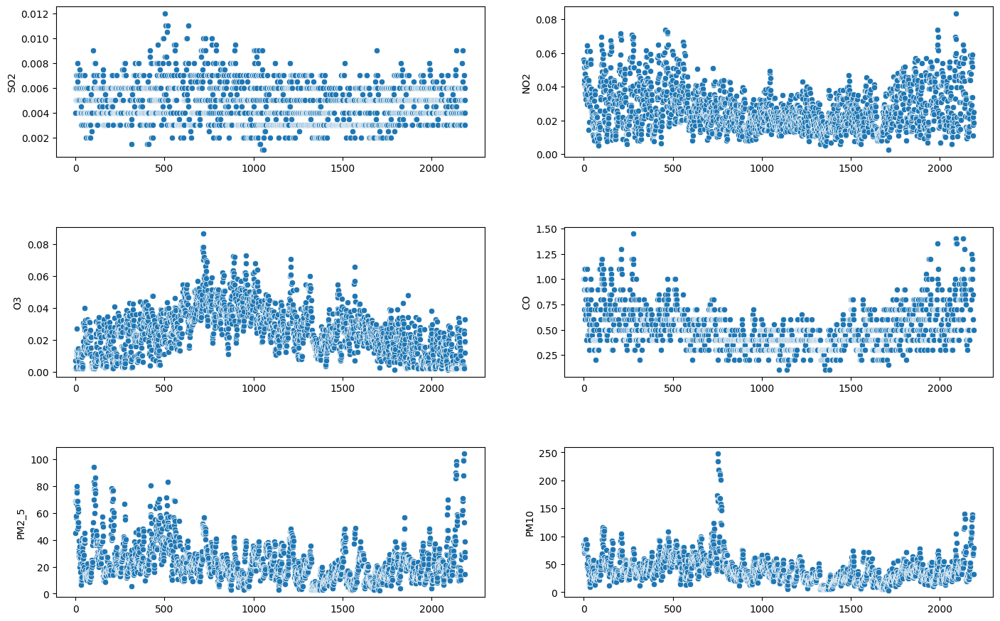

In [55]:
fig, axes = plt.subplots(3, 2, figsize=(15, 10))
fig.tight_layout(pad=5.0)

for param, ax in zip(parameters, axes.flatten()):
    sns.scatterplot(eco[param], ax=ax)

Теперь диаграммы рассеяния для SO2, NO2, O3 и CO выглядят приемлемо - на них не осталось точек, которые можно было бы однозначно классифицировать как выбросы. Что касается PM2.5 и PM10, на графиках для них присутствует достаточно большое количество крупных выбросов. Однако при проведении поиска информации о загрязнении воздуха в Сеуле в 2017 году было выявлено, что в это время там действительно наблюдались случаи превышения допустимой концентрации PM2.5 и PM10 [в несколько раз](https://en.yna.co.kr/view/AEN20190404010800315#:~:text=SEOUL%2C%20April%204%20(Yonhap),U.S.%20civic%20group%20showed%20Thursday.). Следовательно, выбросы в значениях признаков 'PM2_5' и 'PM10' - не ошибки в данных, а реальные пики загрязнения, поэтому продолжим с ними работать.

Таким образом, в данных присутствуют выбросы:
1. Очевидные - все признаки в рамках одного измерения принимают значения 0 или -1. Вероятно, такое поведение вызвано сбоем в работе системы мониторинга. Такие измерения были полностью удалены из таблицы с данными.
2. Точечные выбросы в отдельных признаках - для признаков 'PM2_5', 'PM10' и 'CO' были обнаружены единичные выбросы - как сильные отклонения от данных, так и нулевые значения. В этом случае отклоняющиеся значения были заменены на средние значения данного признака для конкретной станции за текущий месяц.

### 3. Существуют ли корреляционные связи между представленными переменными. Если такие связи есть, насколько они сильны?

Для ответа на этот вопрос построим корреляционную матрицу, которая показывает коэффициенты корреляции между всеми числовыми признаками. Эта матрица позволяет оценить, насколько сильно связаны переменные друг с другом: значения ближе к +1 или -1 указывают на сильную положительную или отрицательную корреляцию соответственно, в то время как значения, близкие к 0, говорят об отсутствии связи.

In [56]:
eco.corr(numeric_only=True)

,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
Station_code,1.000000,0.488460,-0.149182,-0.017560,-0.167744,-0.018720,0.058789
SO2,0.488460,1.000000,0.280632,-0.037353,0.220154,0.334451,0.403139
NO2,-0.149182,0.280632,1.000000,-0.481109,0.716849,0.557547,0.374323
O3,-0.017560,-0.037353,-0.481109,1.000000,-0.410231,-0.082289,0.112705
CO,-0.167744,0.220154,0.716849,-0.410231,1.000000,0.652974,0.444726
PM2_5,-0.018720,0.334451,0.557547,-0.082289,0.652974,1.000000,0.727782
PM10,0.058789,0.403139,0.374323,0.112705,0.444726,0.727782,1.000000


Далее визуализируем эту матрицу и наглядно представим корреляции в форме тепловой карты, где цвета отражают силу и направление корреляций.

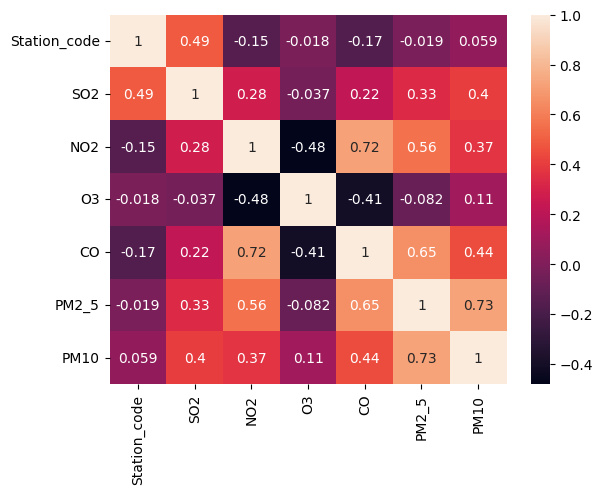

In [57]:
sns.heatmap(eco.corr(numeric_only=True), annot=True);

Дополнительно используем clustermap для кластеризации переменных по их сходству в корреляционных связях. Это поможет выявить группы переменных, которые имеют схожие корреляционные профили.

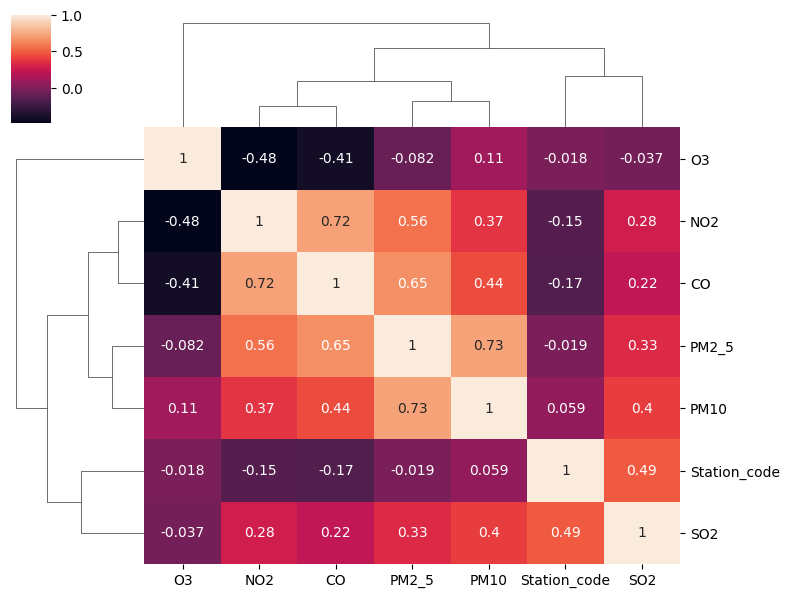

In [58]:
sns.clustermap(eco.corr(numeric_only=True), figsize=(8, 6), annot=True);

Таким образом, самые сильные корреляционные связи наблюдаются у переменных:
- 'PM2_5' и 'PM10' (0.73);
- 'CO' и 'NO2' (0.72);
- 'PM2_5' и 'CO' (0.65);
- 'PM2_5' и 'NO2' (0.56).

### 4. Создайте классификационную модель, которая по составу атмосферного воздуха сможет предсказать, в каком районе вы находитесь. В ходе создания попробуйте несколько методов классификации.

### 4*. Вкратце расскажите о математической базе, стоящей за используемым алгоритмом классификации. Каким образом происходит расчет модели, т. е. какой используется алгоритм и каким образом осуществляется предсказание на основе вновь поступивших данных.

### 4**. Использовали ли подбор гиперпараметров, если использовали, то что это были за гиперпараметры и каким образом осуществлялся подбор?

### 5. Проверьте работоспособность созданной классификационной модели. Расскажите какие метрики качества вы использовали и почему. Если вы создали несколько моделей проверьте работоспособность каждой из них. Интерпретируйте полученные результаты, а именно: существуют ли районы, которые весьма отличаются от всех прочих по характеристикам загрязнения атмосферы.

### 5*) Возможно ли интерпретировать модель, то есть объяснить, что она делает и почему, каким образом осуществляется предсказание? Возможно ли на основе этой интерпретации сделать выводы о наблюдаемых явлениях?

Далее создадим и обучим несколько моделей (логистическая регрессия, случайный лес, метод опорных векторов, градиентный бустинг) для решения задачи мультиклассовой классификации - в рамках каждой из них ответим на вопросы 4, 4*, 4**, 5, 5*.

#### 1. Логистическая регрессия

В первую очередь попробуем применить модель логистической регрессии.

<u> Математическая база, стоящая за моделью: </u>

Логистическая регрессия основана на оценке вероятностей принадлежности объектов к одному из классов. В бинарной классификации используюется сигмоидная функция, чтобы преобразовать линейное выражение в вероятность:                                                
$$
P(y=1∣X)=σ(z)=\frac{1}{1+e^{-z}},
$$ 
где $z=wX+b$, $w$ - вектор весов признаков, $X$ - вектор признаков, $b$ - смещение (bias), $σ(z)$ - сигмоидная функция.

Для задачи мультиклассовой классификации с $K$ классами используется функция Softmax, которая позволяет моделировать вероятности для всех классов одновременно. Вероятность принадлежности объекта $X$ к классу $j$ вычисляется как:
$$
P(y=j∣X) = \frac{e^{z_j}}{\sum^K_{j=1}e^{z_j}},
$$
где $z_j=w_jX+b_j$ - линейная комбинация признаков для $j$-го класса, $w_j,b_j$ - параметры модели класса $j$.

Обучение модели логистической регрессии происходит методом максимального правдоподобия (Maximum Likelihood Estimation). Целевая функция для оптимизации — логарифмическая функция правдоподобия (log-loss или кросс-энтропийная функция потерь). Для многоклассовой классификации функция потерь задается формулой:
$$
L=-\frac{1}{N}\sum^N_{i=1}\sum^K_{j=1}y_{ij}log(P(y=j|X_i)),
$$
где $N$ - количество примеров в выборке, $K$ - количество классов, $y_{ij}$  - индикатор того, что $i$-й пример относится к классу $j$ (принимает значение 1, если это так, и 0 в противном случае).

Параметры $w$ и $b$ оптимизируются с использованием градиентоного спуска. Градиент функции потерь $L$ по параметру $w_j$ для класса $j$ вычисляется как:
$$
\frac{\partial L}{\partial w_j}=-\frac{1}{N}\sum^N_{i=1}(y_{ij}-P(y=j|X_i))X_i,
$$
Аналогично для смещения $b_j$:
$$
\frac{\partial L}{\partial b_j}=-\frac{1}{N}\sum^N_{i=1}(y_{ij}-P(y=j|X_i)),
$$

Для нового объекта $X$ модель рассчитывает вероятность принадлежности к каждому классу $j$, используя Softmax:
$$
P(y=j|X)=\frac{e^{z_j}}{\sum^K_{j=1}e^{z_j}},
$$
Класс с максимальной вероятностью выбирается как предсказанный класс:
$$
\hat y=arg \max_j P(y=j|X)
$$

<u> Создание и обучение модели </u>

Определим набор признаков X и целевую переменную y:

In [101]:
eco

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000
...,...,...,...,...,...,...,...,...
2185,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000
2186,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000
2187,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000
2188,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667


In [102]:
X = eco.drop(['Measurement_date', 'Station_code'], axis=1)
y = eco['Station_code']

Разобьем данные на тренировочную и тестовую выборки:

In [103]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

Выполним масштабирование признаков:

In [104]:
scaler = StandardScaler()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

Создадим модель логистической регрессии:

In [105]:
log_model = LogisticRegression(random_state=101)

<u> Подбор гиперпараметров модели </u>

Для подбора оптимальных гиперпараметров модели воспользуемся поиском по сетке GridSearchCV.

GridSearchCV — это метод, используемый для подбора гиперпараметров модели машинного обучения. Он перебирает различные комбинации заданных гиперпараметров и выполняет кросс-валидацию для каждой из них, чтобы найти оптимальные значения, повышающие точность или другие метрики модели. В конце GridSearchCV возвращает модель с лучшими параметрами.

В случае логистической регрессии для мультиклассовой классификации с помощью GridSearchCV выполним поиск оптимальных значений среди следующих параметров:

1) penalty: ['l1', 'l2'] - определяет тип регуляризации. l1 способствует разреженности модели, приравнивая некоторые коэффициенты к нулю, а l2 уменьшает значения всех коэффициентов.

2) C: np.logspace(0, 4, 10) — коэффициент регуляризации. Он контролирует уровень регуляризации: большие значения C уменьшают регуляризацию, что позволяет модели быть более сложной и потенциально лучше подстраиваться под данные. Маленькие значения C, наоборот, увеличивают регуляризацию и предотвращают переобучение. Использование логарифмического шага позволяет более равномерно исследовать возможные значения регуляризации, делая изменения на порядке C, что часто приводит к лучшим результатам при меньшем числе проверок.

3) solver: ['newton-cg', 'sag', 'saga', 'lbfgs'] - указывает алгоритмы оптимизации, которые будут использоваться для нахождения оптимальных коэффициентов. Все указанные алгоритмы пригодны для мультиклассовой классификации, и каждый из них имеет свои особенности:
- 'newton-cg', 'lbfgs': эффективны для моделей с регуляризацией l2;
- 'saga': поддерживает как l1, так и l2 и может обрабатывать разреженные данные;
- 'sag': эффективен на больших наборах данных, но поддерживает только l2.

4) max_iter: [100, 1000, 5000] - указывает максимальное количество итераций, которое алгоритм будет выполнять до завершения. В логистической регрессии увеличение числа итераций может быть полезно, особенно если данные имеют сложные паттерны.


In [106]:
param_grid_log = {
    'penalty': ['l1', 'l2'],
    'C': np.logspace(0, 4, 10),
    'solver': ['newton-cg', 'sag', 'saga', 'lbfgs'],
    'max_iter': [100, 1000, 5000]
}

In [107]:
grid_model_log = GridSearchCV(log_model, param_grid_log)

Обучим модель на обучающей выборке:

In [108]:
grid_model_log.fit(scaled_X_train, y_train)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The ma

GridSearchCV(estimator=LogisticRegression(random_state=101),
             param_grid={'C': array([1.00000000e+00, 2.78255940e+00, 7.74263683e+00, 2.15443469e+01,
       5.99484250e+01, 1.66810054e+02, 4.64158883e+02, 1.29154967e+03,
       3.59381366e+03, 1.00000000e+04]),
                         'max_iter': [100, 1000, 5000], 'penalty': ['l1', 'l2'],
                         'solver': ['newton-cg', 'sag', 'saga', 'lbfgs']})

Посмотрим на оптимальные гиперпараметры модели, найденные с помощью поиска по сетке:

In [109]:
grid_model_log.best_params_

{'C': 1.0, 'max_iter': 100, 'penalty': 'l1', 'solver': 'saga'}

Сохраним лучшую модель в отдельной переменной:

In [110]:
best_log = grid_model_log.best_estimator_

<u> Оценка работы модели </u>

Оценим работу модели и вычислим основные метрики:

1) Accuracy (точность): для мультиклассовой задачи показывает долю правильно предсказанных классов среди всех. Однако она может быть менее информативной, если классы сильно несбалансированы, так как модель может игнорировать редкие классы, сосредоточившись на преобладающих.

2) Precision (точность) и Recall (полнота): более подходящие для оценки работы модели на несбалансированных данных. Precision показывает, какая доля объектов, предсказанных как определенный класс, действительно относится к этому классу. Recall показывает, какая доля объектов из фактического класса была правильно предсказана. Например, если целью является обнаружение аномалий в данных, высокая полнота будет предпочтительнее.

3) F1-score: гармоническое среднее Precision и Recall, подходящая метрика для задач с несбалансированными классами, когда важно учитывать как количество верных срабатываний, так и точность их классификации.

4) Матрица ошибок (confusion matrix): позволяет увидеть, какие классы чаще всего путаются моделью, что может дать информацию о причинах ошибок и слабых местах модели.

5) ROC AUC и PR AUC: в мультиклассовой классификации можно использовать для каждого класса, применяя подход "один против всех" (one-vs-rest). Это позволяет оценить качество предсказания для каждого класса в отдельности, показывая, насколько модель уверена в своих предсказаниях для каждого класса.

Метрики Precision, Recall и F1-score могут быть рассчитаны для каждого класса по отдельности, а затем усреднены (методы macro или weighted):
- Macro: вычисляет метрики для каждого класса и усредняет их, не учитывая размер класса. Полезно, если важно одинаково оценить качество для каждого класса.
- Weighted: учитывает размер каждого класса при усреднении, что помогает, если классы несбалансированы, так как большие классы оказывают большее влияние на итоговую оценку.

В нашем случае классы хорошо сбалансированы, однако использование всех вышеперечисленных метрик поможет получить комплексное представление о работе модели.

In [111]:
y_pred = grid_model_log.predict(scaled_X_test)

Вычислим метрику точности (accuracy) для оценки качества модели, сравнивая истинные значения (y_test) с предсказанными (y_pred). Этот шаг поможет понять, какой процент тестовых данных модель предсказала верно.

In [112]:
accuracy_score(y_test,y_pred)

0.4861751152073733

Составим матрицу ошибок (confusion matrix), которая показывает количество верных и неверных классификаций для каждого класса. Она позволит увидеть, какие классы чаще путаются моделью.

In [114]:
cm = confusion_matrix(y_test, y_pred)
cm

array([[26,  4, 15, 27,  9,  4],
       [ 4, 23,  2, 16,  7,  7],
       [16, 19, 32, 19,  1,  2],
       [11, 12, 10, 29,  2,  1],
       [ 3,  1,  1,  0, 48, 11],
       [ 1,  4,  2,  0, 12, 53]])

Визуализируем полученную матрицу ошибок.

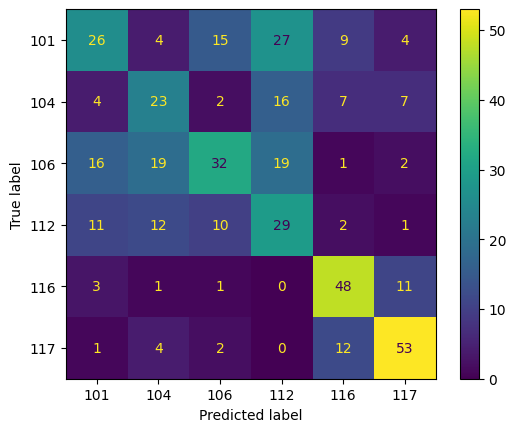

In [115]:
class_names = sorted(y_test.unique())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot();

Отобразим подробный отчет о качестве модели, включающий метрики Precision (точность), Recall (полнота), и F1-score для каждого класса.

In [116]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         101       0.43      0.31      0.36        85
         104       0.37      0.39      0.38        59
         106       0.52      0.36      0.42        89
         112       0.32      0.45      0.37        65
         116       0.61      0.75      0.67        64
         117       0.68      0.74      0.71        72

    accuracy                           0.49       434
   macro avg       0.49      0.50      0.48       434
weighted avg       0.49      0.49      0.48       434



Создадим функцию для построения ROC-кривой для каждой категории (класса) в задаче многоклассовой классификации:

In [117]:
def plot_multiclass_roc(clf, X_test, y_test, figsize=(10,6)):
    station_codes = sorted(y_test.unique())
    
    y_score = clf.decision_function(X_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False)
    
    y_test_dummies = y_test_dummies[station_codes]
    
    for i in range(len(station_codes)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies.iloc[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver Operating Characteristic (ROC) for Logistic Regression')

    # Plot the ROC curve for each station
    for i in range(len(station_codes)):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i]:0.2f}) for station {station_codes[i]}')

    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

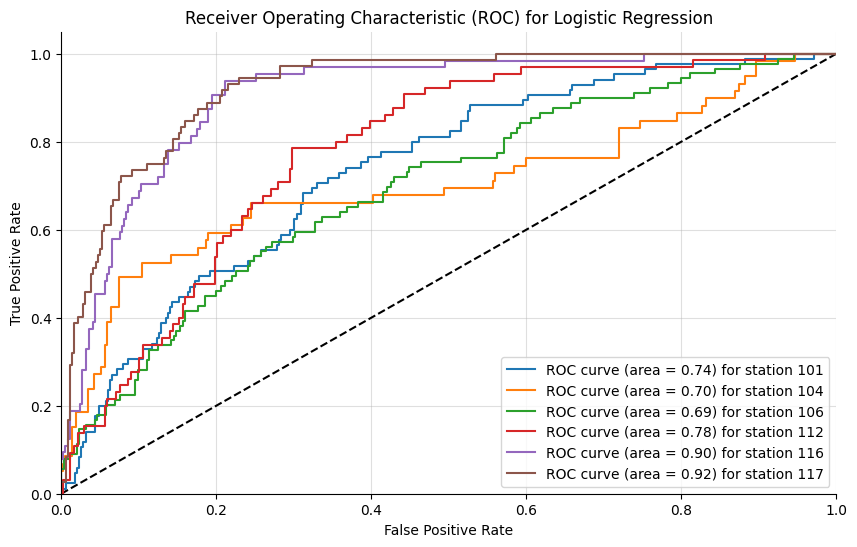

In [118]:
plot_multiclass_roc(grid_model_log, scaled_X_test, y_test)

В результате проведенного анализа, можно сделать несколько выводов о различиях в уровнях загрязнения по районам (кодам станций) на основании значений показателей загрязнения.

1. Общая точность классификации составляет около 49 %, что говорит о том, что модель имеет средний уровень предсказательной способности для различения районов на основе загрязняющих веществ (SO2, NO2, CO, O3, PM2.5, PM10).

2. Лучшие показатели предсказания у районов с кодами станций 116 и 117:
- Код станции 116: Precision = 0.61, Recall = 0.75, F1-score = 0.67.
- Код станции 117: Precision = 0.68, Recall = 0.74, F1-score = 0.71.

    Эти значения говорят о том, что модель лучше распознаёт данные районы по характеристикам загрязнения. Возможно, районы с этими кодами имеют особенные параметры загрязнения, которые позволяют модели их легче отличать.

3. Худшие показатели предсказания наблюдаются для станций с кодами 101, 104, 106 и 112, где Precision и Recall ниже 0.5.
Это может говорить о том, что данные районы имеют схожие характеристики загрязнения, что затрудняет работу модели.

4. Матрица ошибок показывает, что чаще всего ошибки классификации происходят между районами с кодами 101, 104 и 106, что подтверждает гипотезу о схожести их характеристик загрязнения.

5. Анализ ROC-кривых:
ROC-кривые на графике показывают, что для станций с кодами 116 и 117 показатели ROC-AUC выше (0.90 и 0.92 соответственно), что также подтверждает их лучшее качество распознавания по сравнению с другими станциями.
Остальные классы имеют более низкие значения ROC-AUC (в диапазоне от 0.70 до 0.78), что говорит о слабой различимости этих классов. 

Можно сделать вывод о том, что районы с кодами 116 и 117 имеют уникальные параметры загрязнения, которые выделяют их среди остальных. Остальные районы (101, 104, 106, 112) имеют схожие уровни загрязняющих веществ, что затрудняет их разделение и приводит к частым ошибкам классификации.


<u> Интерпретация модели </u>

Логистическая регрессия — это линейная модель, которая предсказывает вероятность принадлежности к определённому классу на основе линейной комбинации признаков. Для каждого объекта модель оценивает вероятность принадлежности ко всем возможным классам, и объект относится к классу с наибольшей вероятностью.

В процессе обучения логистическая регрессия вычисляет коэффициенты для каждого признака, которые показывают, как каждый признак влияет на вероятность принадлежности к тому или иному классу. Например, положительный коэффициент при признаке указывает на то, что увеличение значения этого признака увеличивает вероятность присвоения объекта определённому классу. Более высокие значения коэффициентов для определённых признаков говорят о том, что они больше влияют на предсказание района.

Подбор параметра регуляризации C позволяет модели сбалансировать сложность и устойчивость к переобучению. Важно, что выбор между l1 и l2 регуляризацией также влияет на структуру модели. l1-регуляризация способствует разреженности, обнуляя некоторые коэффициенты, что можно использовать для выявления наиболее значимых признаков. l2-регуляризация, наоборот, приводит к более плавному распределению весов, но при этом уменьшает все коэффициенты.

Модель принимает решение на основе коэффициентов при признаках. Это значит, что признаки с наибольшими весами оказывают наибольшее влияние на предсказание. Если удастся определить, какие признаки сильнее связаны с определёнными классами, это поможет понять, почему модель классифицирует объекты именно таким образом. Например, если для определённого кода станции конкретные признаки имеют высокие коэффициенты, то это может указывать на специфику станции, что позволяет модели корректно предсказывать её. В частности, это может дать понимание о том, что, возможно, в некоторых районах выше концентрация определённых типов загрязнителей.

Для анализа модели логистической регрессии, обученной с помощью GridSearchCV, извлечем оптимальные коэффициенты признаков для каждого класса, чтобы понять, как различные виды загрязнителей влияют на предсказания модели.

Создадим DataFrame, где строки представляют различные классы (Station_code), а столбцы соответствуют признакам. Коэффициенты в таблице показывают вклад каждого признака в предсказания для каждого класса. Положительные коэффициенты указывают на то, что увеличение значения признака увеличивает вероятность отнесения записи к определённому классу, а отрицательные коэффициенты показывают, что увеличение значения признака снижает вероятность отнесения записи к этому классу.

In [119]:
feature_names = X.columns
coefficients = pd.DataFrame(best_log.coef_, columns=feature_names, index=best_log.classes_)
print('Коэффициенты признаков для каждого класса:')
print(coefficients)

Коэффициенты признаков для каждого класса:
          SO2       NO2        O3        CO     PM2_5      PM10
101 -0.233461  0.987363  0.483519 -0.019450 -0.353401 -0.000010
104  0.000000 -0.854020  0.042402  1.055550 -0.331095  0.372741
106 -0.049276  0.195805 -0.000092 -0.238655  0.867942 -0.644108
112 -0.864126 -0.000534  0.366365  0.047381  0.314285 -0.097053
116  2.713323  0.231200 -0.696422 -1.210629 -0.246711  0.142659
117  3.482100 -2.790082 -1.767618  0.309516  0.001148  0.127470


Рассмотрим значения коэффициентов для каждого класса Station_code.

Station_code 101: Показатель NO2 имеет высокий положительный коэффициент (0.987), что указывает на то, что высокие уровни NO2 способствуют предсказанию этого класса. Признаки SO2 и PM2.5 имеют отрицательные коэффициенты, уменьшая вероятность отнесения к классу 101 при их увеличении.

Station_code 104: Значительное влияние на предсказания оказывает CO с положительным коэффициентом (1.056), что говорит о том, что повышенные уровни CO ассоциируются с этим классом. NO2 имеет отрицательное значение (-0.854), что снижает вероятность предсказания класса 104 при увеличении уровня NO2.

Station_code 106: Признак PM2.5 имеет положительное влияние (0.868), а PM10 имеет отрицательное влияние (-0.644), что указывает на различия в концентрации этих веществ для данного класса.

Station_code 112: SO2 имеет сильное отрицательное влияние (-0.864), в то время как O3 положительное (0.366), что говорит о различии в уровнях озона и сернистого газа для этой станции.

Station_code 116: Высокий положительный коэффициент у SO2 (2.713) и отрицательный у CO (-1.211) указывают на то, что для этой станции важны именно уровни сернистого газа и угарного газа.

Station_code 117: Положительный коэффициент у SO2 (3.482) и отрицательный у NO2 (-2.790) и O3 (-1.768) указывают на уникальные комбинации этих признаков для этой станции.

Из полученных коэффициентов можно сделать следующие выводы:
- высокий уровень SO2 может быть индикатором принадлежности к станциям 116 и 117;
- уровень NO2 является важным фактором для предсказаний класса 101, но снижает вероятность отнесения к классу 117;
- уровни загрязняющих веществ, такие как CO и PM2.5, также играют важную роль для некоторых станций.

Далее для анализа значимых признаков в модели логистической регрессии с l1-регуляризацией, посчитаем число ненулевых коэффициентов для каждого признака, чтобы определить, какие из них вносят наибольший вклад в предсказания. Вывод значимых признаков с ненулевыми коэффициентами позволяет понять, какие признаки оказывают влияние на предсказания для каждой станции. Например, если признак имеет ненулевые коэффициенты для нескольких классов, это указывает на его важность для классификации различных станций.

In [120]:
significant_features = (coefficients != 0).sum(axis=0)
print('Число значимых признаков для каждого класса:')
print(significant_features)

Число значимых признаков для каждого класса:
SO2      5
NO2      6
O3       6
CO       6
PM2_5    6
PM10     6
dtype: int64


ВИдно, что почти все признаки имеют ненулевые коэффициенты для большинства классов. Это говорит о том, что каждый из шести параметров оказывает влияние на классификацию станций и вносит вклад в предсказания для разных классов.

NO2, O3, CO, PM2.5, PM10 — являются значимыми признаками для всех шести классов. Это указывает на то, что данные параметры влияют на различие между всеми станциями, и модель активно использует их для классификации. Возможно, эти показатели варьируются в зависимости от местоположения станций, отражая различия в экологических и промышленных особенностях районов.

SO2 — значим для пяти классов из шести, что указывает на его важность, хотя немного меньшую по сравнению с другими показателями. Это может быть связано с тем, что содержание SO2 более специфично для некоторых станций, возможно, связанных с промышленными выбросами или с определённой экологической ситуацией в районе.

Далее проведем анализ и определим топ-5 значимых признаков для каждого класса, в результате которого выявим наиболее важные признаки, оказывающие наибольшее влияние на классификацию для каждой станции. Эти признаки характеризуются наибольшими по модулю коэффициентами, указывающими на сильное влияние на вероятностное предсказание для конкретного класса.

In [121]:
for class_label in best_log.classes_:
    top_features = coefficients.loc[class_label].abs().nlargest(5).index
    print(f'Топ-5 значимых признаков для класса {class_label}: {top_features.tolist()}')

Топ-5 значимых признаков для класса 101: ['NO2', 'O3', 'PM2_5', 'SO2', 'CO']
Топ-5 значимых признаков для класса 104: ['CO', 'NO2', 'PM10', 'PM2_5', 'O3']
Топ-5 значимых признаков для класса 106: ['PM2_5', 'PM10', 'CO', 'NO2', 'SO2']
Топ-5 значимых признаков для класса 112: ['SO2', 'O3', 'PM2_5', 'PM10', 'CO']
Топ-5 значимых признаков для класса 116: ['SO2', 'CO', 'O3', 'PM2_5', 'NO2']
Топ-5 значимых признаков для класса 117: ['SO2', 'NO2', 'O3', 'CO', 'PM10']


Далее провести аналогичное исследование с использованием модели Random Forest.

#### 2. Случайный лес (Random Forest)

Случайный лес (Random Forest) - ансамблевая техника, которая использует несколько деревьев решений для классификации или регрессии. Каждое дерево в лесу строится с использованием случайных подмножеств обучающих данных и случайных подмножеств признаков на каждом шаге деления.

<u> Математическая база, стоящая за моделью: </u>

Для каждого дерева из обучающей выборки случайным образом выбираются подмножества примеров (с повторением) из общей выборки. Это означает, что для каждого дерева создается новое случайное подмножество данных, называемое бутстрап-выборкой.

На каждом узле дерева случайным образом выбирается подмножество признаков (это уменьшает корреляцию между деревьями и помогает избежать переобучения).

Каждое дерево строится как обычное дерево решений, но при делении на каждом узле используется только случайное подмножество признаков. Для задач классификации деление происходит на основе минимизации неопределенности (например, критерия Джини или энтропии).

Критерий Джини для классификации для узла можно записать как:
$$
Gini(t) = 1-\sum^K_{j=1}p_j^2,
$$ 
где $p_j$ - доля примеров, принадлежащих классу $j$ в узле $t$, $K$ - количество классов.

В конечных узлах (листьях) деревьев находятся прогнозы. Для задачи классификации в листе дерева хранится вероятность каждого класса, основанная на относительном числе примеров каждого класса в этом листе.

Для предсказания нового объекта $X$ в каждом дереве делается предсказание.
Для классификации предсказания всех деревьев агрегируются методом голосования (модальностью — класс с наибольшим количеством голосов).
$$
\hat y=arg \max_j \sum^T_{i=1}I_{y_i=j},
$$
где $T$ -количество деревьев, $I_{y_i=j}$ - индикатор того, что $i$-е дерево предсказало класс $j$.

<u> Создание и обучение модели </u>

Определим набор признаков X и целевую переменную y:

In [122]:
eco

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000
...,...,...,...,...,...,...,...,...
2185,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000
2186,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000
2187,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000
2188,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667


In [123]:
X = eco.drop(['Measurement_date', 'Station_code'], axis=1)
y = eco['Station_code']

Разобьем данные на тренировочную и тестовую выборки:

In [124]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

Random Forests не требует масштабирования признаков, поэтому сразу создадим модель RandomForestClassifier:

In [125]:
rfc_model = RandomForestClassifier(random_state=101)

<u> Подбор гиперпараметров модели </u>

Для подбора оптимальных гиперпараметров модели воспользуемся поиском по сетке GridSearchCV.

В случае модели Randon Forest будем выбирать следующие параметры:

1. n_estimators: [64, 100, 128, 200] — количество деревьев в ансамбле. Чем больше количество деревьев, тем стабильнее будет модель, но с увеличением числа деревьев растет вычислительная сложность. Обычно количество деревьев должно быть достаточно большим для улучшения качества модели, но без излишней нагрузки на вычислительные ресурсы. По умолчанию n_estimators = 100, попробуем значения как меньше, так и больше этого.

2. max_features: [2, 3, 4] — максимальное количество признаков, которые могут быть использованы для разделения каждого узла. Выбор небольшого числа признаков помогает избежать переобучения, но с увеличением этого числа модель может лучше подстраиваться под данные, снижая ошибку на обучающей выборке. По умолчанию max_features = sqrt(n_features), вместо этого попробоуем выбрать целые значения, близкие к значению по умолчанию.

3. bootstrap: [True, False] — указывает, использовать ли бутстрэппинг (выбор случайных подвыборок с возвратом) для создания каждой из обучающих выборок. Если значение True, то для каждого дерева в случайном лесе будет выбираться подмножество обучающих данных с возвратом. Если False, то все данные будут использоваться для обучения каждого дерева.

4. oob_score: [True, False] — указывает, использовать ли вневыборочную оценку (out-of-bag score) для оценки модели на объектах, которые не были выбраны для обучения каждого дерева. Если значение True, модель рассчитывает оценку точности на вневыборочных объектах, что позволяет оценить модель без выделения отдельного тестового набора. Если False, вневыборочная оценка отключена.

In [126]:
param_grid_rfc = {
    'n_estimators': [64,100,128,200],
    'max_features': [2,3,4],
    'bootstrap': [True,False],
    'oob_score': [True,False]
}

In [127]:
grid_model_rfc = GridSearchCV(rfc_model, param_grid_rfc)

Обучим модель на обучающей выборке:

In [128]:
grid_model_rfc.fit(X_train, y_train)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/model_selection/_validation.py:547: FitFailedWarning: 
60 fits failed out of a total of 240.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
60 fits failed with the following error:
Traceback (most recent call last):
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/model_selection/_validation.py", line 895, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py", line 1474, in wrapper
    return fit_method(estimator, *args, **kwargs)
           ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File 

GridSearchCV(estimator=RandomForestClassifier(random_state=101),
             param_grid={'bootstrap': [True, False], 'max_features': [2, 3, 4],
                         'n_estimators': [64, 100, 128, 200],
                         'oob_score': [True, False]})

Посмотрим на оптимальные гиперпараметры модели, найденные с помощью поиска по сетке:

In [129]:
grid_model_rfc.best_params_

{'bootstrap': True, 'max_features': 2, 'n_estimators': 200, 'oob_score': True}

Сохраним лучшую модель в отдельную переменную:

In [130]:
best_rfc = grid_model_rfc.best_estimator_

<u> Оценка работы модели </u>

Оценим работу модели и вычислим основные метрики. Аналогично модели логистической регрессии, будем использовать такие метрики, как Accuracy, Precision, Recall, F1-score, Confusion matrix, ROC AUC, но в дополнение к ним вычислим OOB-ошибку (Out-of-Bag error), которая оценивает ошибку на данных, не попавших в бутстрап-выборку для каждого дерева.

In [131]:
y_pred = grid_model_rfc.predict(X_test)

Вычислим метрику точности (accuracy) для оценки качества модели, сравнивая истинные значения (y_test) с предсказанными (y_pred).

In [132]:
accuracy_score(y_test,y_pred)

0.6013824884792627

Составим матрицу ошибок (confusion matrix), которая показывает количество верных и неверных классификаций для каждого класса.

In [133]:
cm = confusion_matrix(y_test,y_pred)
cm

array([[38,  4, 19, 13,  5,  6],
       [ 5, 38,  5,  6,  5,  0],
       [17,  9, 47, 10,  4,  2],
       [13,  9, 14, 26,  2,  1],
       [ 1,  0,  3,  0, 52,  8],
       [ 1,  3,  3,  3,  2, 60]])

Визуализируем полученную матрицу ошибок.

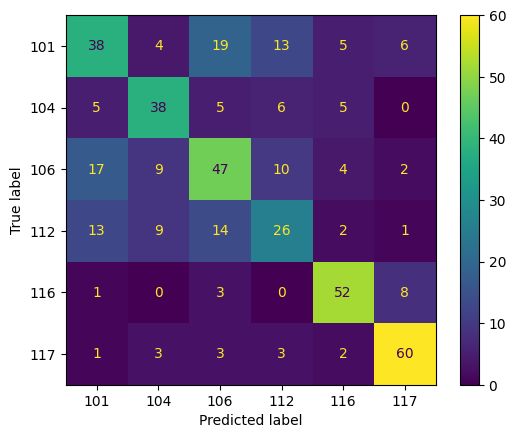

In [134]:
class_names = sorted(y_test.unique())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot();

Отобразим подробный отчет о качестве модели, включающий метрики Precision (точность), Recall (полнота), и F1-score для каждого класса.

In [135]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         101       0.51      0.45      0.47        85
         104       0.60      0.64      0.62        59
         106       0.52      0.53      0.52        89
         112       0.45      0.40      0.42        65
         116       0.74      0.81      0.78        64
         117       0.78      0.83      0.81        72

    accuracy                           0.60       434
   macro avg       0.60      0.61      0.60       434
weighted avg       0.59      0.60      0.60       434



Вычислим метрику oob_score:

In [136]:
grid_model_rfc.best_estimator_.oob_score_

0.5426267281105991

Создадим функцию для построения ROC-кривой для каждой категории (класса) в задаче многоклассовой классификации:

In [137]:
def plot_multiclass_roc(clf, X_test, y_test, figsize=(10,6)):
    station_codes = sorted(y_test.unique())
    
    y_score = clf.predict_proba(X_test)
    
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False).values
    
    for i in range(len(station_codes)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver Operating Characteristic (ROC) for Random Forest')

    for i in range(len(station_codes)):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i]:0.2f}) for station {station_codes[i]}')

    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

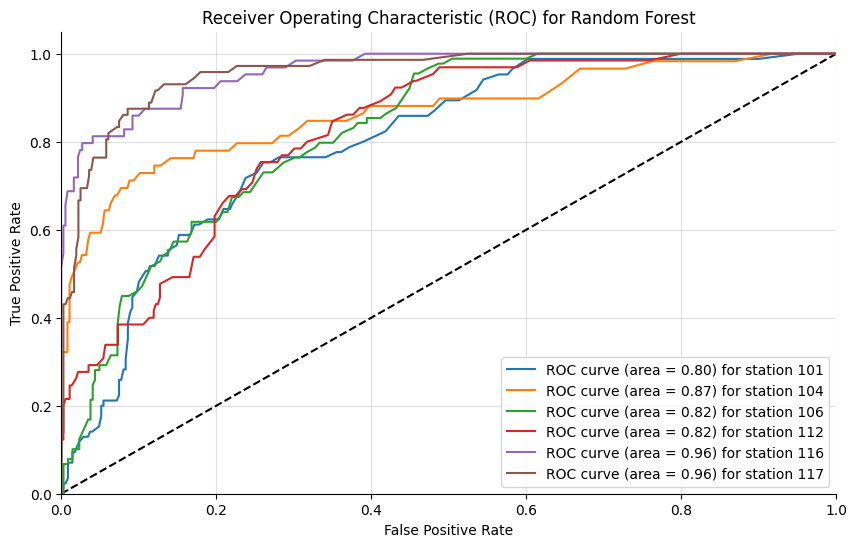

In [100]:
plot_multiclass_roc(grid_model_rfc, X_test, y_test)

В результате проведенного анализа, можно сделать несколько выводов о различиях в уровнях загрязнения по районам (кодам станций) на основании значений показателей загрязнения.

1. Общая точность классификации составляет 60 %, что указывает на умеренный уровень предсказательной способности модели для различения районов по загрязняющим веществам (SO2, NO2, CO, O3, PM2.5, PM10). Несмотря на значительное улучшение по сравнению с моделью логистической регрессии (49 %), точность всё ещё не слишком высокая, что может свидетельствовать о наличии схожих характеристик загрязнения среди некоторых районов.

2. Лучшие показатели предсказания наблюдаются у районов с кодами станций 116 и 117:
- Код станции 116: Precision = 0.74, Recall = 0.81, F1-score = 0.78
- Код станции 117: Precision = 0.78, Recall = 0.83, F1-score = 0.81

    Эти значения подтверждают, что модель распознает эти районы значительно лучше. Высокие показатели Precision и Recall указывают на то, что модель точно классифицирует данные районы и редко ошибается. Возможно, станции с кодами 116 и 117 имеют уникальные и отчетливые характеристики загрязнения, что облегчает их различение.

3. Худшие показатели предсказания наблюдаются для станций с кодами 101, 104, 106 и 112, где Precision и Recall находятся в районе 0.4 - 0.6:
- Код станции 101: Precision = 0.51, Recall = 0.45, F1-score = 0.47
- Код станции 104: Precision = 0.60, Recall = 0.64, F1-score = 0.62
- Код станции 106: Precision = 0.52, Recall = 0.53, F1-score = 0.52
- Код станции 112: Precision = 0.45, Recall = 0.40, F1-score = 0.42 

    Эти результаты могут свидетельствовать о том, что районы с этими кодами имеют схожие или менее выраженные характеристики загрязнения, что затрудняет для модели их различение и приводит к низким показателям классификации.

4. Матрица ошибок показывает, что наиболее частые ошибки классификации происходят между станциями с кодами 101, 104 и 112. Это подтверждает гипотезу о схожести загрязнения в этих районах, что затрудняет их различение.

5. Анализ ROC-кривых:
ROC-кривые на графике показывают, что для станций с кодами 116 и 117 показатели ROC-AUC выше (0.96, 0.96), что также подтверждает их лучшее качество распознавания по сравнению с другими станциями.
Остальные классы имеют более низкие значения ROC-AUC (в диапазоне от 0.80 до 0.87).

6. Анализ OOB-ошибок (Out-of-Bag error) для модели случайного леса показывает значение OOB = 0.543, что немного ниже, чем точность на тестовых данных. Это подтверждает, что модель может быть улучшена, и ошибки на обучающих данных также присутствуют.

Таким образом, модель случайного леса, как и модель логистической регрессии, показывает лучшее качество распознавания для станций с кодами 116 и 117, что говорит об их уникальных параметрах загрязнения. Станции с кодами 101, 104, 106 и 112 имеют схожие уровни загрязняющих веществ, что затрудняет их различение и приводит к частым ошибкам классификации.


<u> Интерпретация модели </u>

Модель случайного леса является одним из ансамблевых методов, который состоит из множества деревьев решений. 

Каждый из этих деревьев обучается на случайно выбранной подвыборке данных и использует случайный выбор признаков для каждого разбиения. В результате, случайный лес объединяет предсказания всех деревьев для получения окончательного результата. 

Из-за своей структуры модель случайного леса часто воспринимается как "черный ящик", поскольку не даёт явной интерпретации относительно того, какие именно признаки вносят наибольший вклад в предсказания. Однако можно провести оценку того, насколько улучшение чистоты разделения (например, уменьшение энтропии или ошибки) зависит от каждого признака. Чем выше значение важности, тем больше этот признак влияет на результат модели. Для вывода важности признаков в sklearn можно использовать атрибут feature_importances_. Это позволит увидеть, какие загрязняющие вещества наиболее влияют на классификацию.

После обучения модели, извлечем важность признаков, чтобы понять, какие признаки наиболее влияют на предсказания модели.

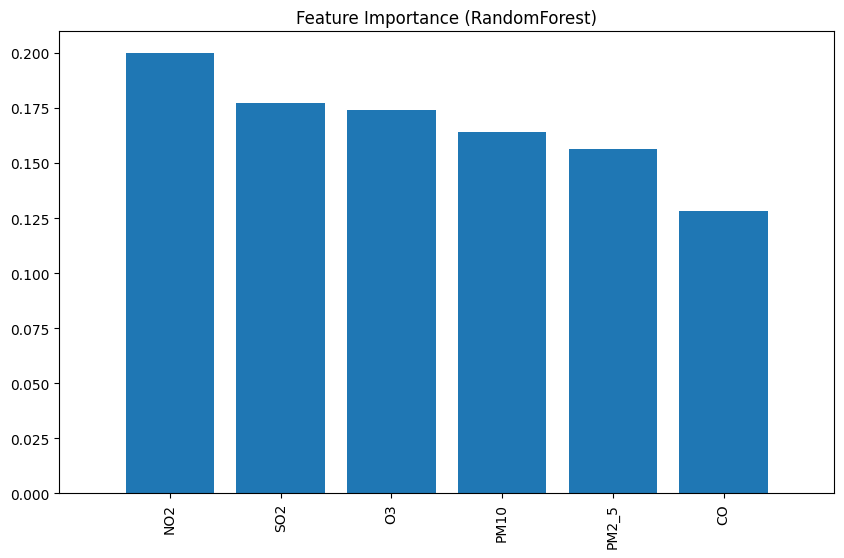

In [138]:
importances = best_rfc.feature_importances_

indices = np.argsort(importances)[::-1]

columns = X_train.columns

plt.figure(figsize=(10, 6))
plt.title('Feature Importance (RandomForest)')
plt.bar(range(X_train.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train.shape[1]), columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]]);

Видно, что наибольшее влияние на проедсказания модели оказывает признак 'NO2', далее следуют 'SO2', 'O3', 'PM10', 'PM2_5', 'CO' соответственно.

#### 3. Метод опорных векторов (SVM)

Метод опорных векторов (Support Vector Machine, SVM) — это метод классификации, который ищет гиперплоскость, максимально разделяющую классы в пространстве признаков. Задача SVM — найти такую гиперплоскость, которая максимизирует зазор (или отступ), т.е. расстояние от ближайших точек каждого класса до гиперплоскости. Эти ближайшие точки называются опорными векторами.

<u> Математическая база, стоящая за моделью: </u>

Для задачи мультиклассовой классификации SVM использует два основных подхода:

- One-vs-One (OvO) — для каждого возможного сочетания двух классов обучается отдельный классификатор, который решает, к какому из двух классов принадлежит объект.

- One-vs-All (OvA) — для каждого класса обучается классификатор, который отделяет этот класс от всех остальных. То есть, для каждого класса мы обучаем классификатор, который должен определить, принадлежит ли объект этому классу или нет.

Если данные не линейно разделимы, SVM использует ядра (kernels), чтобы проецировать данные в более высокое пространство признаков, где классы могут быть линейно разделимы.

В линейной версии задачи SVM находит гиперплоскость с максимальным зазором между классами, решая задачу оптимизации:
$$
minimize\frac{1}{2}||w||^2
$$
при условии, что:
$$
y_i(wx_i+b)\geq 1,  \forall i
$$
где $w$ — вектор весов, $b$ — смещение, $x_i$​ — вектор признаков объекта, $y_i$​ — метка класса для объекта $i$.

В случае, когда данные не идеально разделимы, добавляется параметр регуляризации, который позволяет допустить ошибки в классификации, чтобы улучшить общее качество модели.

Для предсказания на новых данных SVM вычисляет, на какой стороне гиперплоскости находится объект, и, основываясь на обученных классификаторах (в случае мультиклассовой классификации), предсказывает, к какому классу он относится.
В методе One-vs-All объект классифицируется по каждому классификатору, и присваивается класс с наибольшей "уверенностью". В методе One-vs-One решается, какой класс побеждает в большинстве классификаций.

Таким образом, SVM строит эффективные границы принятия решений, которые позволяют точно классифицировать объекты в мультиклассовых задачах.

<u> Создание и обучение модели </u>

Определим набор признаков X и целевую переменную y:

In [139]:
eco

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000
...,...,...,...,...,...,...,...,...
2185,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000
2186,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000
2187,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000
2188,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667


In [140]:
X = eco.drop(['Measurement_date', 'Station_code'], axis=1)
y = eco['Station_code']

Разобьем данные на тренировочную и тестовую выборки:

In [141]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

Выполним масштабирование признаков:

In [142]:
scaler = StandardScaler()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

Создадим модель логистической регрессии:

In [143]:
svm = SVC(probability=True, random_state=101)

<u> Подбор гиперпараметров модели </u>

Для подбора оптимальных гиперпараметров модели воспользуемся поиском по сетке GridSearchCV.

В случае метода SVM для классификации с помощью GridSearchCV будем выбирать следующие параметры:
1. C: [0.001,0.01,0.1,0.5,1] — параметр регуляризации. Параметр C контролирует баланс между ошибками классификации и шириной зазора между классами. Низкие значения C позволяют модели быть более гибкой, что может помочь избежать переобучения, но увеличивает количество ошибок на обучающих данных. Высокие значения C заставляют модель стараться минимизировать ошибки, что может привести к переобучению.
2. kernel: ['linear', 'poly', 'rbf', 'sigmoid'] — функция ядра. Параметр kernel определяет тип ядра, которое используется для преобразования данных в пространство более высокой размерности. Ядро 'linear' используется, когда данные линейно разделимы, а 'rbf' (радиально-базисное ядро) — когда данные нелинейно разделимы. Ядро 'poly' использует полиномиальную функцию, 'sigmoid' — сигмоидальную.
3. gamma: [′scale′,′auto′] — параметр, управляющий шириной гауссового ядра. Параметр gamma контролирует форму ядра. При значении 'scale' (по умолчанию) gamma рассчитывается как 1/((число признаков)*(среднеквадратическое отклонение всех данных))​, что часто дает хорошие результаты. В случае 'auto' gamma рассчитывается как 1/(число признаков)​, что может быть менее оптимально для сложных данных.


In [144]:
param_grid_svm = {
    'C':[0.001,0.01,0.1,0.5,1],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'gamma':['scale','auto'],
}

In [145]:
grid_model_svm = GridSearchCV(svm, param_grid_svm)

Обучим модель на обучающей выборке:

In [146]:
grid_model_svm.fit(scaled_X_train, y_train)

GridSearchCV(estimator=SVC(probability=True, random_state=101),
             param_grid={'C': [0.001, 0.01, 0.1, 0.5, 1],
                         'gamma': ['scale', 'auto'],
                         'kernel': ['linear', 'poly', 'rbf', 'sigmoid']})

Посмотрим на оптимальные гиперпараметры модели, найденные с помощью поиска по сетке:

In [147]:
grid_model_svm.best_params_

{'C': 1, 'gamma': 'scale', 'kernel': 'rbf'}

Сохраним лучшую модель в отдельную переменную:

In [149]:
best_svm = grid_model_svm.best_estimator_

<u> Оценка работы модели </u>

Оценим работу модели и вычислим основные метрики: Accuracy, Precision, Recall, F1-score, Confusion matrix, ROC AUC.

In [150]:
y_pred = grid_model_svm.predict(scaled_X_test)

Вычислим метрику точности (accuracy) для оценки качества модели:

In [151]:
accuracy_score(y_test,y_pred)

0.5967741935483871

Составим матрицу ошибок (confusion matrix):

In [152]:
cm = confusion_matrix(y_test,y_pred)
cm

array([[37,  3, 20, 14,  7,  4],
       [ 4, 28,  5, 12,  7,  3],
       [19,  6, 52,  8,  2,  2],
       [ 8,  5, 18, 32,  1,  1],
       [ 1,  1,  3,  0, 48, 11],
       [ 1,  2,  2,  1,  4, 62]])

Визуализируем полученную матрицу ошибок.

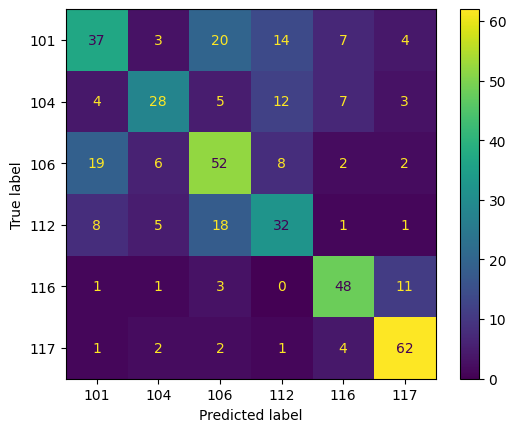

In [153]:
class_names = sorted(y_test.unique())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot();

Отобразим подробный отчет о качестве модели, включающий метрики Precision (точность), Recall (полнота), и F1-score для каждого класса.

In [154]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         101       0.53      0.44      0.48        85
         104       0.62      0.47      0.54        59
         106       0.52      0.58      0.55        89
         112       0.48      0.49      0.48        65
         116       0.70      0.75      0.72        64
         117       0.75      0.86      0.80        72

    accuracy                           0.60       434
   macro avg       0.60      0.60      0.60       434
weighted avg       0.59      0.60      0.59       434



Создадим функцию для построения ROC-кривой для каждой категории (класса) в задаче многоклассовой классификации:

In [155]:
def plot_multiclass_roc(clf, X_test, y_test, figsize=(10,6)):
    station_codes = sorted(y_test.unique())
    
    y_score = clf.decision_function(X_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False).values
    
    for i in range(len(station_codes)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver Operating Characteristic (ROC) for SVM')

    for i in range(len(station_codes)):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i]:0.2f}) for station {station_codes[i]}')
    
    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

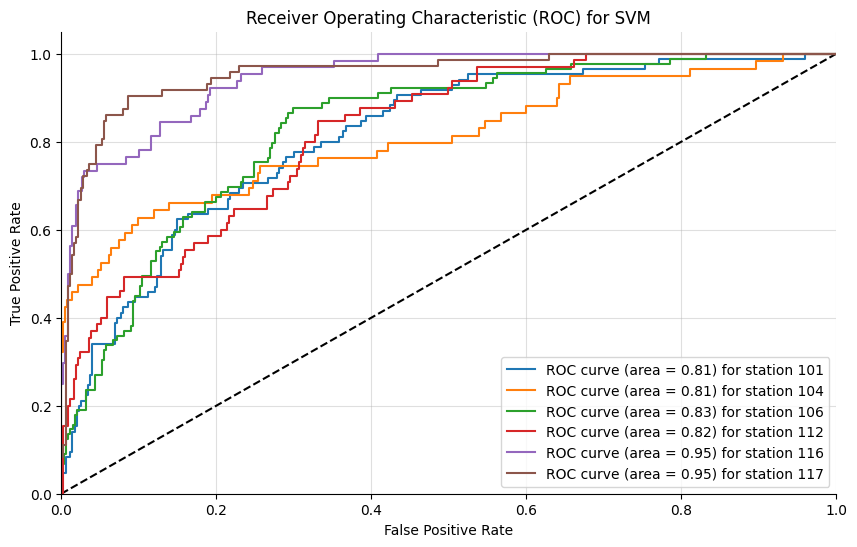

In [156]:
plot_multiclass_roc(grid_model_svm, scaled_X_test, y_test)

В результате проведенного анализа, можно сделать несколько выводов о различиях в уровнях загрязнения по районам (кодам станций) на основании значений показателей загрязнения.

1. Confusion Matrix: матрица показывает, что модель делает ошибки между классами. Например, для станции с кодом 101 модель часто путает её со станцией 106 (19 ошибок). Для станции 117 модель достигает наибольшей точности (62 правильных предсказаний из 72).

2. Precision (точность):
Точность для разных станций варьируется от 0.48 до 0.75, что указывает на среднюю производительность модели.
Наивысшая точность достигнута для станции с кодом 117 (0.75), то есть модель реже ошибается, когда классифицирует эту станцию.
Наименьшая точность у станции 112 (0.48), что показывает, что модель часто ошибается, классифицируя её.

3. Recall (полнота):
Полнота варьируется от 0.44 до 0.86.
Станции 116 и 117 имеют высокие значения recall (0.75 и 0.86), показывая, что модель чаще успешно распознает эти станции.
Полнота для станции 101 самая низкая (0.44), что указывает, что модель часто не распознает эту станцию.

4. F1-score:
Наивысшее значение F1-score у станции 117 (0.80), что отражает баланс между точностью и полнотой.
Самые низкие F1-score у станций 101 и 112 (0.48), что означает, что для этих классов модель работает менее стабильно.

5. Средние значения (macro avg и weighted avg):
Средние значения (0.60 для precision, recall и F1) показывают, что модель работает посредственно на всех классах в целом.
При этом weighted avg близко к accuracy (0.59), что означает, что модель сбалансированно подходит ко всем станциям, учитывая их количество.

6. Анализ ROC-кривых:
ROC-кривые на графике показывают, что для станций с кодами 116 и 117 показатели ROC-AUC выше (0.95, 0.95), что также подтверждает их лучшее качество распознавания по сравнению с другими станциями.
Остальные классы имеют более низкие значения ROC-AUC (в диапазоне от 0.81 до 0.83).


<u> Интерпретация модели </u>

Модель SVC с радиально-базисной функцией (RBF) ядра (при kernel='rbf') предназначена для классификации данных, которые сложно разделить линейно. Она находит сложные нелинейные границы между классами, что позволяет эффективно классифицировать данные, которые линейные модели не могут разделить.

RBF-ядро позволяет преобразовать данные из исходного пространства признаков в пространство более высокой размерности. В этом пространстве становятся различимыми даже те классы, которые в исходном пространстве перекрываются. Это достигается благодаря тому, что радиально-базисная функция оценивает сходство каждого экземпляра с другими точками, создавая нелинейные границы, более подходящие для сложных структур данных.

Когда модель обучена, она создает границу принятия решения между классами на основе выбранных параметров и распределения данных.
При поступлении нового примера SVC оценивает, с какой стороны этой нелинейной границы он находится. Если пример ближе к точкам одного класса, он классифицируется как принадлежащий этому классу.

Таким образом, модель SVC с RBF-ядром делает предсказания, ориентируясь на сходство примеров в пространстве высокой размерности, благодаря чему она находит сложные границы, разделяющие классы. Поэтому эта модель сложна для интерпретации и практически невозможно прямо понять, как каждый признак влияет на предсказание.

#### 4. Градиентный бустинг (Gradient Boosting)

Модель градиентного бустинга (Gradient Boosting) — это метод ансамблевого обучения, который строит последовательность слабых моделей (обычно деревьев решений), улучшая каждую последующую модель путем корректировки ошибок предыдущих.

<u> Математическая база, стоящая за моделью: </u>

Основная идея заключается в том, чтобы на каждом шаге обучения строить модель, которая уменьшает ошибку предыдущих моделей. Модели строятся поочередно, и каждая последующая модель пытается исправить ошибки, сделанные на предыдущем шаге. Это достигается за счет минимизации функции потерь с использованием градиентного спуска.

Предположим, что у нас есть набор обучающих данных $\{ (x_i,y_i) \}$, где $x_i$​ — признаки, а $y_i​$ — целевая переменная. Мы стремимся построить функцию $F(x)$, которая будет аппроксимировать истинную целевую переменную %y_i%​ для каждого объекта %x_i%​.

Пусть на $t$-м шаге у нас есть предсказание $F_{t−1}(x)$. Тогда на $t$-м шаге мы добавляем новое дерево $h_t(x)$ так, чтобы улучшить предсказания, уменьшив ошибку предыдущей модели.

Обновление модели на каждом шаге выполняется по следующей формуле:
$$
F_t(x)=F_{t−1}(x)+ηh_t(x),
$$
где $η$ — это параметр обучения (learning rate), контролирующий степень обновления модели на каждом шаге.

На каждом шаге модели мы минимизируем функцию потерь $L$, которая обычно является функцией, измеряющей расхождение между предсказанными и истинными значениями. Например, для задачи классификации это может быть кросс-энтропия.

Для того чтобы оптимизировать $F_t(x)$, мы минимизируем функцию потерь по параметрам модели, используя градиентный спуск. Математически это выглядит так:
$$
L(F_t)=\sum^N_{i=1}L(y_i,F_t(x_i)),
$$
где $N$ — количество обучающих примеров, $y_i$​ — истинное значение, $F_t(x_i)$ — предсказанное значение для объекта $x_i$​.

Чтобы построить новую модель $h_t(x)$, мы ищем ее как градиент функции потерь по текущим предсказаниям $F_{t−1}(x)$. Для этого вычисляется градиент функции потерь $L$ по текущим предсказаниям $F_{t−1}(x)$:
$$
g_i=\frac{\partial L(y_i, F_{t-1}(x_i))}{\partial F_{t-1}(x_i)},
$$
где $g_i$​ — градиент ошибки для каждого примера.

Далее, для вычисления нового дерева $h_t(x)$ используется градиентный спуск по сумме квадратов этих градиентов, что позволяет моделировать ошибки и отклонения текущего предсказания.

Конечная модель представляет собой сумму всех деревьев, построенных на каждом шаге:
$$
F(x)=F_0(x)+\sum^T_{t=1}ηh_t(x),
$$
где $T$ — количество шагов (или деревьев) в ансамбле.

Каждое дерево $h_t(x)$ находит локальное улучшение, уменьшая ошибку предыдущей модели, что позволяет создавать мощные и точные предсказания.

<u> Создание и обучение модели </u>

Определим набор признаков X и целевую переменную y:

In [157]:
eco

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000
...,...,...,...,...,...,...,...,...
2185,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000
2186,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000
2187,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000
2188,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667


In [158]:
X = eco.drop(['Measurement_date', 'Station_code'], axis=1)
y = eco['Station_code']

Разобьем данные на тренировочную и тестовую выборки:

In [159]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

Масштабирование признаков не требуется, сразу создадим модель гридиентного бустинга:

In [160]:
gb_model = GradientBoostingClassifier(random_state=101)

<u> Подбор гиперпараметров модели </u>

Для подбора оптимальных гиперпараметров модели GradientBoostingClassifier воспользуемся поиском по сетке GridSearchCV.

В случае метода градиентного бустинга для классификации с помощью GridSearchCV будем выбирать следующие параметры:

1. n_estimators: [1, 5, 10, 20, 40, 100, 150, 200] — количество деревьев в ансамбле. Этот параметр контролирует, сколько базовых моделей (деревьев) будет построено в процессе обучения. Низкие значения n_estimators могут привести к недообучению, так как модель не будет иметь достаточно деревьев для формирования сильных предсказаний. Высокие значения увеличивают точность, но могут вызвать переобучение.

2. max_depth: [3, 4, 5, 6] — максимальная глубина каждого дерева. Этот параметр определяет максимальную сложность каждого базового дерева. Меньшие значения max_depth ограничивают сложность деревьев и помогают предотвратить переобучение, но могут сделать модель недостаточно точной. Более высокие значения увеличивают способность модели к подгонке, что может улучшить точность, но также повысить риск переобучения.


In [161]:
param_grid_gb = {
    "n_estimators":[1, 5, 10, 20, 40, 100, 150, 200],
    'max_depth':[3, 4, 5, 6]
}

In [162]:
grid_model_gb = GridSearchCV(gb_model, param_grid_gb)

Обучим модель на обучающей выборке:

In [163]:
grid_model_gb.fit(X_train, y_train)

GridSearchCV(estimator=GradientBoostingClassifier(random_state=101),
             param_grid={'max_depth': [3, 4, 5, 6],
                         'n_estimators': [1, 5, 10, 20, 40, 100, 150, 200]})

Посмотрим на оптимальные гиперпараметры модели, найденные с помощью поиска по сетке:

In [164]:
grid_model_gb.best_params_

{'max_depth': 4, 'n_estimators': 100}

Сохраним лучшую модель в отдельную переменную:

In [165]:
best_gb = grid_model_gb.best_estimator_

<u> Оценка работы модели </u>

Оценим работу модели и вычислим основные метрики: Accuracy, Precision, Recall, F1-score, Confusion matrix, ROC AUC.

In [166]:
y_pred = grid_model_gb.predict(X_test)

Вычислим метрику точности (accuracy) для оценки качества модели:

In [167]:
accuracy_score(y_test,y_pred)

0.5875576036866359

Составим матрицу ошибок (confusion matrix):

In [168]:
cm = confusion_matrix(y_test,y_pred)
cm

array([[37,  4, 19, 16,  6,  3],
       [ 6, 36,  2,  8,  5,  2],
       [25,  8, 46,  8,  1,  1],
       [10,  7, 17, 28,  2,  1],
       [ 1,  0,  2,  0, 52,  9],
       [ 1,  2,  4,  0,  9, 56]])

Визуализируем полученную матрицу ошибок.

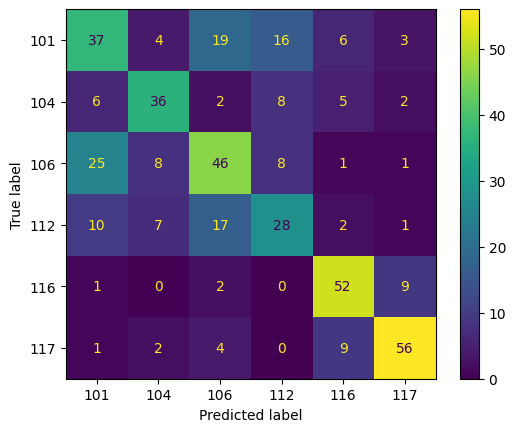

In [170]:
class_names = sorted(y_test.unique())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot();

Отобразим подробный отчет о качестве модели, включающий метрики Precision (точность), Recall (полнота), и F1-score для каждого класса.

In [171]:
print(classification_report(y_test,y_pred))

              precision    recall  f1-score   support

         101       0.46      0.44      0.45        85
         104       0.63      0.61      0.62        59
         106       0.51      0.52      0.51        89
         112       0.47      0.43      0.45        65
         116       0.69      0.81      0.75        64
         117       0.78      0.78      0.78        72

    accuracy                           0.59       434
   macro avg       0.59      0.60      0.59       434
weighted avg       0.58      0.59      0.58       434



Создадим функцию для построения ROC-кривой для каждой категории (класса) в задаче многоклассовой классификации:

In [172]:
def plot_multiclass_roc(clf, X_test, y_test, figsize=(10,6)):
    station_codes = sorted(y_test.unique())
    
    y_score = clf.predict_proba(X_test)
    
    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False).values
    
    for i in range(len(station_codes)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver Operating Characteristic (ROC) for Gradient Boosting')

    for i in range(len(station_codes)):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i]:0.2f}) for station {station_codes[i]}')

    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

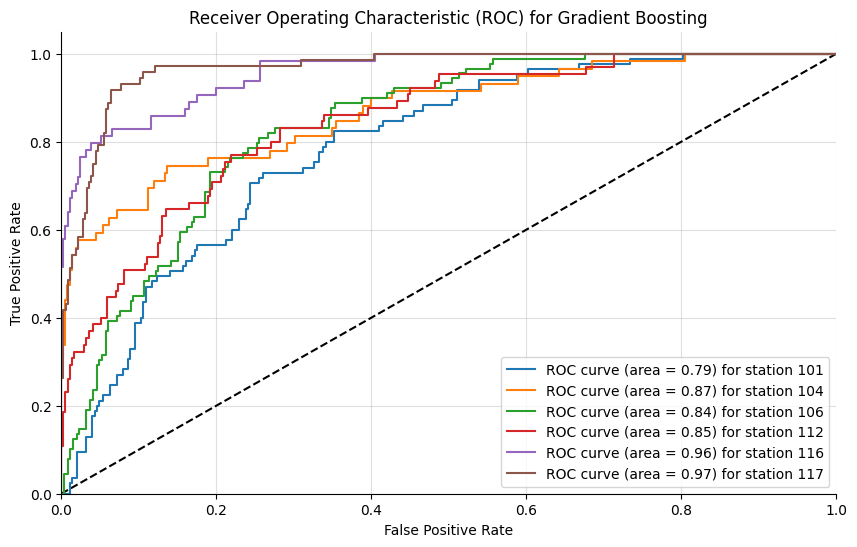

In [173]:
plot_multiclass_roc(grid_model_gb, X_test, y_test)

В результате проведенного анализа, можно сделать несколько выводов о различиях в уровнях загрязнения по районам (кодам станций) на основании значений показателей загрязнения.

1. Матрица ошибок показывает, что модель часто путает некоторые станции. Например, для станции с кодом 101 модель часто ошибается, классифицируя её как другие станции, особенно как 106 и 112 (сделано 25 и 10 ошибок соответственно). Для станции 117 модель демонстрирует наилучшую точность, с 56 правильными предсказаниями из 72.

2. Precision (точность): Точность для разных станций варьируется от 0.46 до 0.78, что указывает на среднюю производительность модели.
Наивысшая точность достигнута для станции с кодом 117 (0.78), что показывает, что модель реже ошибается при классификации этой станции.
Наименьшая точность у станции 101 (0.46), что говорит о том, что модель часто ошибается при классификации этой станции.

3. Recall (полнота): Полнота варьируется от 0.43 до 0.81.
Станции 116 и 117 имеют высокие значения recall (0.81 и 0.78 соответственно), что означает, что модель часто правильно классифицирует эти станции.
Для станции 112 полнота самая низкая (0.43), что указывает на то, что модель часто не распознает эту станцию.

4. F1-score: Наивысший F1-score у станции 117 (0.78), что отражает хороший баланс между точностью и полнотой.
Самые низкие F1-score у станций 101 и 112 (0.45 у обеих), что означает, что для этих классов модель работает менее стабильно.

5. Средние значения (macro avg и weighted avg): Macro avg для precision, recall и F1-score равны 0.59, 0.60, 0.59 соответственно, что показывает, что модель работает посредственно на всех классах в целом.
Weighted avg составляет 0.58 - 0.59, что близко к общей точности (0.59) и означает, что модель сбалансированно подходит ко всем станциям, учитывая их количество.

6. Анализ ROC-кривых: ROC-кривые показывают, что для станций с кодами 116 и 117 показатели ROC-AUC выше (0.96, 0.97 соответственно), что подтверждает их лучшее качество распознавания по сравнению с другими станциями.
Для других классов показатели ROC-AUC ниже, в диапазоне от 0.79 до 0.87, что указывает на менее точную работу модели для этих станций.


Таким образом, модель показывает среднюю производительность, с наилучшими результатами для станций с кодами 116 и 117.

<u> Интерпретация модели </u>

В модели градиентного бустинга каждое дерево в ансамбле принимает объект на вход и делает свое предсказание.

Модель собирает результаты всех деревьев и комбинирует их для формирования итогового предсказания.

Для классификации итоговый результат часто определяется путем голосования (каждое дерево "голосует" за класс, и выбирается класс, за который проголосовало большинство деревьев).

Таким образом, в Gradient Boosting Classifier предсказание основывается на суммировании предсказаний всех слабых моделей (деревьев) с учетом их важности и коррекции ошибок на каждом шаге обучения.

Хотя модели Gradient Boosting Classifier в целом не являются легко интерпретируемыми (так как они используют сложный ансамбль деревьев решений), есть несколько способов объяснить, что происходит в модели и как она принимает решения.

Например, один из подходов для интерпретации модели — это анализ важности признаков. В процессе обучения модель присваивает каждому признаку значение, которое показывает, насколько этот признак влияет на итоговое решение модели. Это можно вычислить с помощью атрибута feature_importances_ модели, который позволит понять, какие характеристики данных наиболее влияют на предсказание.

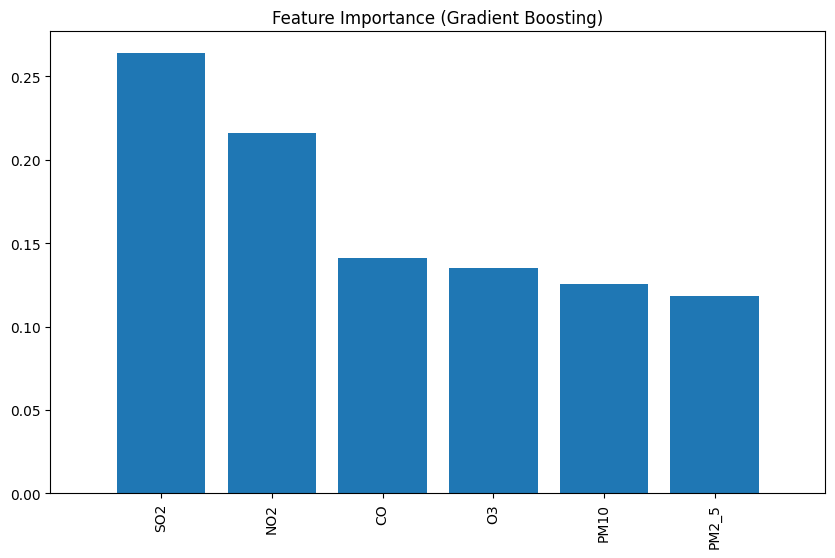

In [174]:
importances = best_gb.feature_importances_

indices = np.argsort(importances)[::-1]

columns = X_train.columns

plt.figure(figsize=(10, 6))
plt.title('Feature Importance (Gradient Boosting)')
plt.bar(range(X_train.shape[1]), importances[indices], align="center")
plt.xticks(range(X_train.shape[1]), columns[indices], rotation=90)
plt.xlim([-1, X_train.shape[1]]);

Видно, что наибольшую важность имеют признаки 'SO2' и 'NO2', далее следуют 'CO', 'O3', 'PM10', 'PM2_5' соответственно.

#### Выводы о работе четырех моделей

Создадим сводную таблицу с результатами работы (метриками) для всех четырех опробованных моделей:

In [177]:
data = {
    'Model': ['Gradient Boosting', 'Gradient Boosting', 'Gradient Boosting', 'Gradient Boosting', 
              'SVM', 'SVM', 'SVM', 'SVM', 
              'Random Forest', 'Random Forest', 'Random Forest', 'Random Forest', 
              'Logistic Regression', 'Logistic Regression', 'Logistic Regression', 'Logistic Regression'],
    'Metric': ['AUC', 'Precision', 'Recall', 'F1-score', 
               'AUC', 'Precision', 'Recall', 'F1-score', 
               'AUC', 'Precision', 'Recall', 'F1-score', 
               'AUC', 'Precision', 'Recall', 'F1-score'],
    '101': [0.79, 0.46, 0.44, 0.45, 0.81, 0.53, 0.44, 0.48, 0.80, 0.51, 0.45, 0.47, 0.74, 0.43, 0.31, 0.36],
    '104': [0.87, 0.63, 0.61, 0.62, 0.81, 0.62, 0.47, 0.54, 0.87, 0.60, 0.64, 0.62, 0.70, 0.37, 0.39, 0.38],
    '106': [0.84, 0.51, 0.52, 0.51, 0.83, 0.52, 0.58, 0.55, 0.82, 0.52, 0.53, 0.52, 0.69, 0.52, 0.36, 0.42],
    '112': [0.85, 0.47, 0.43, 0.45, 0.82, 0.48, 0.49, 0.48, 0.82, 0.45, 0.40, 0.42, 0.78, 0.32, 0.45, 0.37],
    '116': [0.96, 0.69, 0.81, 0.75, 0.95, 0.70, 0.75, 0.72, 0.96, 0.74, 0.81, 0.78, 0.90, 0.61, 0.75, 0.67],
    '117': [0.97, 0.78, 0.78, 0.78, 0.95, 0.75, 0.86, 0.80, 0.96, 0.78, 0.83, 0.81, 0.92, 0.68, 0.74, 0.71],
    'Accuracy': [0.59, None, None, None, 0.60, None, None, None, 0.60, None, None, None, 0.49, None, None, None],
    'Macro avg': [0.60, None, None, None, 0.60, None, None, None, 0.61, None, None, None, 0.50, None, None, None],
    'Weighted avg': [0.58, None, None, None, 0.59, None, None, None, 0.60, None, None, None, 0.49, None, None, None]
}

df = pd.DataFrame(data)

melted_df = pd.melt(df, id_vars=['Model', 'Metric'], var_name='Dataset', value_name='Score')

pivot_df = melted_df.pivot_table(index=['Model', 'Metric'], columns='Dataset', values='Score', aggfunc='first')


In [178]:
pivot_df

Dataset                         101   104   106   112   116   117  Accuracy  \
Model               Metric                                                    
Gradient Boosting   AUC        0.79  0.87  0.84  0.85  0.96  0.97      0.59   
                    F1-score   0.45  0.62  0.51  0.45  0.75  0.78       NaN   
                    Precision  0.46  0.63  0.51  0.47  0.69  0.78       NaN   
                    Recall     0.44  0.61  0.52  0.43  0.81  0.78       NaN   
Logistic Regression AUC        0.74  0.70  0.69  0.78  0.90  0.92      0.49   
                    F1-score   0.36  0.38  0.42  0.37  0.67  0.71       NaN   
                    Precision  0.43  0.37  0.52  0.32  0.61  0.68       NaN   
                    Recall     0.31  0.39  0.36  0.45  0.75  0.74       NaN   
Random Forest       AUC        0.80  0.87  0.82  0.82  0.96  0.96      0.60   
                    F1-score   0.47  0.62  0.52  0.42  0.78  0.81       NaN   
                    Precision  0.51  0.60  0.52  0.45  0.74  0.78       NaN   
                    Recall     0.45  0.64  0.53  0.40  0.81  0.83       NaN   
SVM                 AUC        0.81  0.81  0.83  0.82  0.95  0.95      0.60   
                    F1-score   0.48  0.54  0.55  0.48  0.72  0.80       NaN   
                    Precision  0.53  0.62  0.52  0.48  0.70  0.75       NaN   
                    Recall     0.44  0.47  0.58  0.49  0.75  0.86       NaN   

Dataset                        Macro avg  Weighted avg  
Model               Metric                              
Gradient Boosting   AUC             0.60          0.58  
                    F1-score         NaN           NaN  
                    Precision        NaN           NaN  
                    Recall           NaN           NaN  
Logistic Regression AUC             0.50          0.49  
                    F1-score         NaN           NaN  
                    Precision        NaN           NaN  
                    Recall           NaN           NaN  
Random Forest       AUC             0.61          0.60  
                    F1-score         NaN           NaN  
                    Precision        NaN           NaN  
                    Recall           NaN           NaN  
SVM                 AUC             0.60          0.59  
                    F1-score         NaN           NaN  
                    Precision        NaN           NaN  
                    Recall           NaN           NaN

На основе проведенного анализа можно сделать следующие выводы:

1. Random Forest выглядит лучшей моделью для этой задачи многоклассовой классификации. Она демонстрирует хороший баланс между точностью, полнотой и F1-Score, особенно для наиболее важных станций (116 и 117). Также она хорошо справляется с задачей по точности и AUC.

2. SVM и Gradient Boosting также показывают хорошие результаты, с высокими значениями AUC и хорошей производительностью по многим меткам.

3. Logistic Regression — слабый исполнитель по сравнению с остальными моделями, особенно по точности, полноте и F1-Score.

### 5**) Попробуйте применить метамоделирование. Каким образом вы его реализовали и смогли ли вы улучшить показатели качества классификации?

Модели SVM и Random Forest кажутся наиболее сильными кандидатами для метамоделирования. Обе модели показывают стабильные и высокие значения AUC, Precision, Recall и F1-score. Эти модели могут дать метамодели разнообразие в предсказаниях, которое полезно для улучшения итоговых результатов.

Gradient Boosting также является хорошим выбором, так как показывает очень высокие результаты в AUC и F1-score, особенно на более сложных наборах данных. Он может дополнительно улучшить метамодель за счёт своей сильной склонности к обучению на сложных признаках.

Таким образом, для метамоделирования выберем SVM, Random Forest и Gradient Boosting. Эти модели предоставляют различные подходы к классификации, что повысит разнообразие метамодели и улучшит её общее качество.

In [179]:
eco

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000
...,...,...,...,...,...,...,...,...
2185,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000
2186,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000
2187,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000
2188,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667


Обозначим набор признаков X и целевую переменную y:

In [180]:
X = eco[['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']]
y = eco['Station_code'] 

Разделим данные на обучающий и тестовый наборы:

In [181]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=101)

Выполним масштабирование признаков:

In [184]:
scaler = StandardScaler()
scaled_X_train = scaler.fit_transform(X_train)
scaled_X_test = scaler.transform(X_test)

Получим предсказания вероятностей с лучших моделей, которые мы ранее сохранили в отдельные переменные:

In [185]:
rfc_probs = best_rfc.predict_proba(scaled_X_test)
gb_probs = best_gb.predict_proba(scaled_X_test)
svm_probs = best_svm.predict_proba(scaled_X_test)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but RandomForestClassifier was fitted with feature names
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/base.py:493: UserWarning: X does not have valid feature names, but GradientBoostingClassifier was fitted with feature names
  warnings.warn(


Объединим предсказания моделей в новую таблицу:

In [186]:
meta_features = np.hstack([svm_probs, rfc_probs, gb_probs])

Обучим метамодель (логистическую регрессию):

In [187]:
meta_model = LogisticRegression(random_state=101)

Выполним подбор гиперпараметров с помощью поиска по сетке:

In [189]:
param_grid_meta = {
    'penalty': ['l1', 'l2'],
    'C': np.logspace(0, 4, 10),
    'solver': ['newton-cg', 'sag', 'saga', 'lbfgs'],
    'max_iter': [100, 1000, 5000]
}

In [190]:
grid_model_meta = GridSearchCV(meta_model, param_grid_meta)

In [191]:
grid_model_meta.fit(meta_features, y_test)

/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The max_iter was reached which means the coef_ did not converge
  warnings.warn(
/Library/Frameworks/Python.framework/Versions/3.11/lib/python3.11/site-packages/sklearn/linear_model/_sag.py:350: ConvergenceWarning: The ma

GridSearchCV(estimator=LogisticRegression(random_state=101),
             param_grid={'C': array([1.00000000e+00, 2.78255940e+00, 7.74263683e+00, 2.15443469e+01,
       5.99484250e+01, 1.66810054e+02, 4.64158883e+02, 1.29154967e+03,
       3.59381366e+03, 1.00000000e+04]),
                         'max_iter': [100, 1000, 5000], 'penalty': ['l1', 'l2'],
                         'solver': ['newton-cg', 'sag', 'saga', 'lbfgs']})

Посмотрим на лучшие гиперпараметры метамодели:

In [192]:
grid_model_meta.best_params_

{'C': 21.544346900318832, 'max_iter': 1000, 'penalty': 'l1', 'solver': 'saga'}

Получим прогнозы метамодели:

In [193]:
meta_preds = grid_model_meta.predict(meta_features)

Оценим работу метамодели и вычислим основные метрики: Accuracy, Precision, Recall, F1-score, ROC AUC.

In [194]:
accuracy = accuracy_score(y_test, meta_preds)
accuracy

0.6451612903225806

In [195]:
cm = confusion_matrix(y_test, meta_preds)
cm

array([[45,  5, 16, 10,  5,  4],
       [ 5, 35,  8,  4,  6,  1],
       [17,  5, 54, 10,  1,  2],
       [ 8,  3, 18, 35,  0,  1],
       [ 1,  1,  3,  0, 50,  9],
       [ 1,  1,  3,  0,  6, 61]])

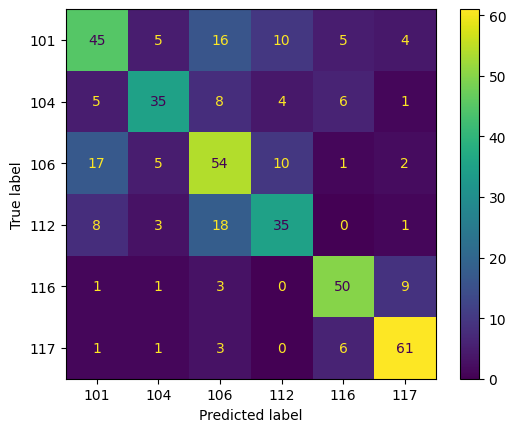

In [196]:
class_names = sorted(y_test.unique())
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
disp.plot();

In [197]:
print(classification_report(y_test, meta_preds))

              precision    recall  f1-score   support

         101       0.58      0.53      0.56        85
         104       0.70      0.59      0.64        59
         106       0.53      0.61      0.57        89
         112       0.59      0.54      0.56        65
         116       0.74      0.78      0.76        64
         117       0.78      0.85      0.81        72

    accuracy                           0.65       434
   macro avg       0.65      0.65      0.65       434
weighted avg       0.65      0.65      0.64       434



In [198]:
def plot_multiclass_roc(clf, X_test, y_test, figsize=(10,6)):
    station_codes = sorted(y_test.unique())
    
    y_score = clf.predict_proba(X_test)

    fpr = dict()
    tpr = dict()
    roc_auc = dict()

    y_test_dummies = pd.get_dummies(y_test, drop_first=False)
    y_test_dummies = y_test_dummies[station_codes]

    for i in range(len(station_codes)):
        fpr[i], tpr[i], _ = roc_curve(y_test_dummies.iloc[:, i], y_score[:, i])
        roc_auc[i] = auc(fpr[i], tpr[i])

    fig, ax = plt.subplots(figsize=figsize)
    ax.plot([0, 1], [0, 1], 'k--')
    ax.set_xlim([0.0, 1.0])
    ax.set_ylim([0.0, 1.05])
    ax.set_xlabel('False Positive Rate')
    ax.set_ylabel('True Positive Rate')
    ax.set_title('Receiver Operating Characteristic (ROC) for Meta Model')

    for i in range(len(station_codes)):
        ax.plot(fpr[i], tpr[i], label=f'ROC curve (area = {roc_auc[i]:0.2f}) for station {station_codes[i]}')

    ax.legend(loc="best")
    ax.grid(alpha=.4)
    sns.despine()
    plt.show()

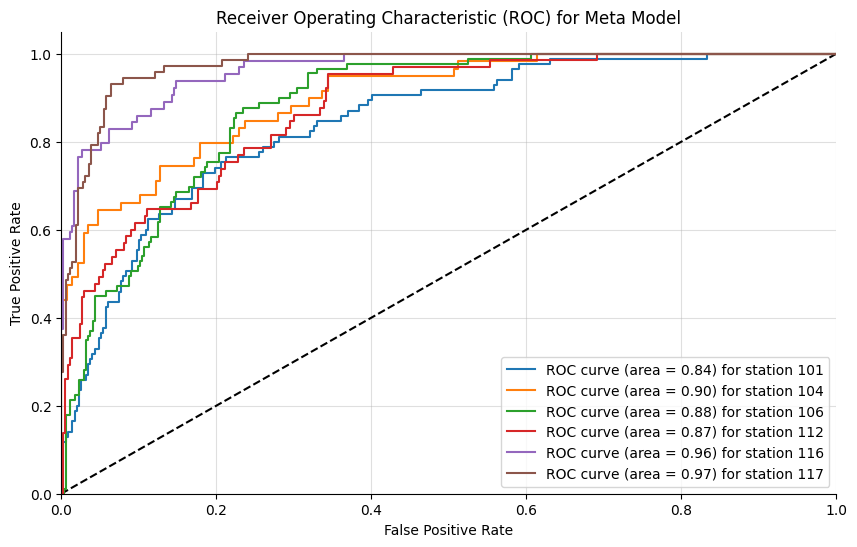

In [199]:
plot_multiclass_roc(grid_model_meta, meta_features, y_test)

В результате проведенного анализа, можно сделать несколько выводов о работе метамодели.

1. Метамодель в целом показала улучшения в классификации по AUC для большинства классов, особенно для класса 101, где была наибольшая разница. Это означает, что комбинирование отдельных моделей улучшило способность различать классы.

2. Метамодель улучшила F1-оценку для классов с более низкими показателями (101, 104, 106) и показала сопоставимые или лучшие результаты для классов с высокой производительностью.

3. Для классов 116 и 117, где отдельные модели показывали хорошие результаты, метамодель сохранила эту производительность и даже немного улучшила ее.

Таким образом, использование метамодели позволило улучшить качество классификации, особенно для классов с низким AUC и F1-мерой (например, класс 101). Метамодель показала хорошую способность комбинировать различные модели и улучшить их общие результаты.


### 6) Проверьте предположение о том, что если станции наблюдения расположены относительно недалеко друг от друга, то они регистрируют в целом схожие характеристики загрязнения атмосферы

Для проверки предположения о том, что станции наблюдения, расположенные относительно недалеко друг от друга, регистрируют схожие характеристики загрязнения атмосферы, объединеним данные из обоих датасетов (eco и coords):

In [200]:
coords.head()

,Address,Station code,Latitude,Longitude
0,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",101,37.572016,127.005008
1,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",102,37.564263,126.974676
2,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",103,37.540033,127.004850
3,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",104,37.609823,126.934848
4,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",105,37.593742,126.949679


Создадим функцию для выделения названия района из полного адреса станции:

In [201]:
def extract_district(address):
    parts = address.split(', ')
    district_with_gu = parts[-3]
    return  district_with_gu

Создадим новую колонку 'District' в таблице coords:

In [202]:
coords['District'] = coords['Address'].apply(extract_district)

In [203]:
coords.head()

,Address,Station code,Latitude,Longitude,District
0,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",101,37.572016,127.005008,Jongno-gu
1,"15, Deoksugung-gil, Jung-gu, Seoul, Republic o...",102,37.564263,126.974676,Jung-gu
2,"136, Hannam-daero, Yongsan-gu, Seoul, Republic...",103,37.540033,127.004850,Yongsan-gu
3,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",104,37.609823,126.934848,Eunpyeong-gu
4,"32, Segeomjeong-ro 4-gil, Seodaemun-gu, Seoul,...",105,37.593742,126.949679,Seodaemun-gu


In [204]:
eco.head()

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10
0,2017-01-01,101,0.004,0.0560,0.002,1.0,69.0,85.0
1,2017-01-01,104,0.006,0.0420,0.007,0.7,45.0,70.0
2,2017-01-01,106,0.005,0.0550,0.003,1.1,67.5,78.0
3,2017-01-01,112,0.005,0.0440,0.002,0.9,69.0,82.0
4,2017-01-01,116,0.006,0.0515,0.002,1.0,56.5,73.0


Объединим таблицы eco и coords по столбцу 'Station_code':

In [205]:
coords.rename(columns={'Station code': 'Station_code'}, inplace=True)

full_data = eco.merge(coords, on='Station_code', how='inner')

In [206]:
full_data

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10,Address,Latitude,Longitude,District
0,2017-01-01,101,0.004,0.0560,0.0020,1.00,69.0,85.000000,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,Jongno-gu
1,2017-01-01,104,0.006,0.0420,0.0070,0.70,45.0,70.000000,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848,Eunpyeong-gu
2,2017-01-01,106,0.005,0.0550,0.0030,1.10,67.5,78.000000,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597,Mapo-gu
3,2017-01-01,112,0.005,0.0440,0.0020,0.90,69.0,82.000000,"49, Samyang-ro 139-gil, Gangbuk-gu, Seoul, Rep...",37.647930,127.011952,Gangbuk-gu
4,2017-01-01,116,0.006,0.0515,0.0020,1.00,56.5,73.000000,"71, Gangseo-ro 45da-gil, Gangseo-gu, Seoul, Re...",37.544640,126.835151,Gangseo-gu
...,...,...,...,...,...,...,...,...,...,...,...,...
2165,2017-12-31,104,0.003,0.0175,0.0240,0.85,30.5,73.000000,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848,Eunpyeong-gu
2166,2017-12-31,106,0.005,0.0220,0.0185,0.60,31.0,70.500000,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597,Mapo-gu
2167,2017-12-31,112,0.004,0.0110,0.0330,0.50,27.0,68.500000,"49, Samyang-ro 139-gil, Gangbuk-gu, Seoul, Rep...",37.647930,127.011952,Gangbuk-gu
2168,2017-12-31,116,0.003,0.0250,0.0190,0.50,14.5,32.166667,"71, Gangseo-ro 45da-gil, Gangseo-gu, Seoul, Re...",37.544640,126.835151,Gangseo-gu


Cравненим местоположения станций и границ районов в Сеуле. Для этого создадим карту с границами имеющихся в наших данных районов. Для создания карты используем файл GeoJSON, доступный в [этом репозитории на GitHub](https://github.com/southkorea/seoul-maps). Это JSON-файл, содержащий данные о географических объектах в определённой стандартизированной структуре. В качестве системы координат используется WGS 84 — стандартная система, применяемая в GPS.

In [208]:
with open('data/seoul_municipalities_geo_simple.json', 'r') as file:
    district_borders = json.loads(file.read())

In [209]:
district_borders

{'type': 'FeatureCollection',
 'features': [{'type': 'Feature',
   'geometry': {'type': 'Polygon',
    'coordinates': [[[127.05181987399999, 37.685815952999974],
      [127.05195432999994, 37.68295554600002],
      [127.05124372099999, 37.68200315500002],
      [127.050936224, 37.68010014399999],
      [127.04973706099997, 37.676724165999985],
      [127.04887969799995, 37.67518859900002],
      [127.04820611399998, 37.67048413200001],
      [127.04893704599999, 37.667590002],
      [127.05142672199997, 37.663973570999985],
      [127.051469816, 37.66042898699999],
      [127.05343323299996, 37.65751023399997],
      [127.054073077, 37.654496732999974],
      [127.05376492699997, 37.652060053000014],
      [127.05396756200003, 37.650582568],
      [127.05545541100003, 37.64824690299997],
      [127.05584227600002, 37.64705617300001],
      [127.05566746900001, 37.64460474399999],
      [127.05516606799995, 37.643454948],
      [127.05513914699998, 37.64133787499998],
      [127.0547437

Посмотрим, с какими районами мы работали:

In [210]:
full_data['District'].unique()

array(['Jongno-gu', 'Eunpyeong-gu', 'Mapo-gu', 'Gangbuk-gu', 'Gangseo-gu',
       'Guro-gu'], dtype=object)

Создадим интерактивную карту с помощью библиотеки Folium, чтобы визуализировать данные о станциях мониторинга и границах районов.

In [212]:
stations_map = folium.Map(location=[37.562600, 127.024612], tiles='cartodbpositron', zoom_start=11)

district_names_to_display = full_data['District'].unique()

for feature in district_borders['features']:
    district_name = feature['properties']['SIG_ENG_NM']
    if district_name in district_names_to_display:
        folium.GeoJson(
            feature,
            name='geojson'
        ).add_to(stations_map)

for idx, row in full_data.iterrows():
    popup_text = f"{row['Station_code']}: {row['District']}"
    Marker([row['Latitude'], row['Longitude']], popup=popup_text).add_to(stations_map)

stations_map

Можно нажать на маркер на карте, чтобы увидеть номер и район станции.

Для географического анализа данных вычислим среднюю концентрацию каждого загрязняющего вещества по районам. Чтобы значения были сопоставимыми, применим нормализацию, вычитая среднее значение и деля на стандартное отклонение для каждого загрязняющего вещества.

Далее визуализируем нормализованные уровни загрязняющих веществ по станциям и построим тепловую карту heatmap. Тепловая карта поможет увидеть, какие станции имеют более высокие или низкие уровни по каждому загрязняющему веществу. 

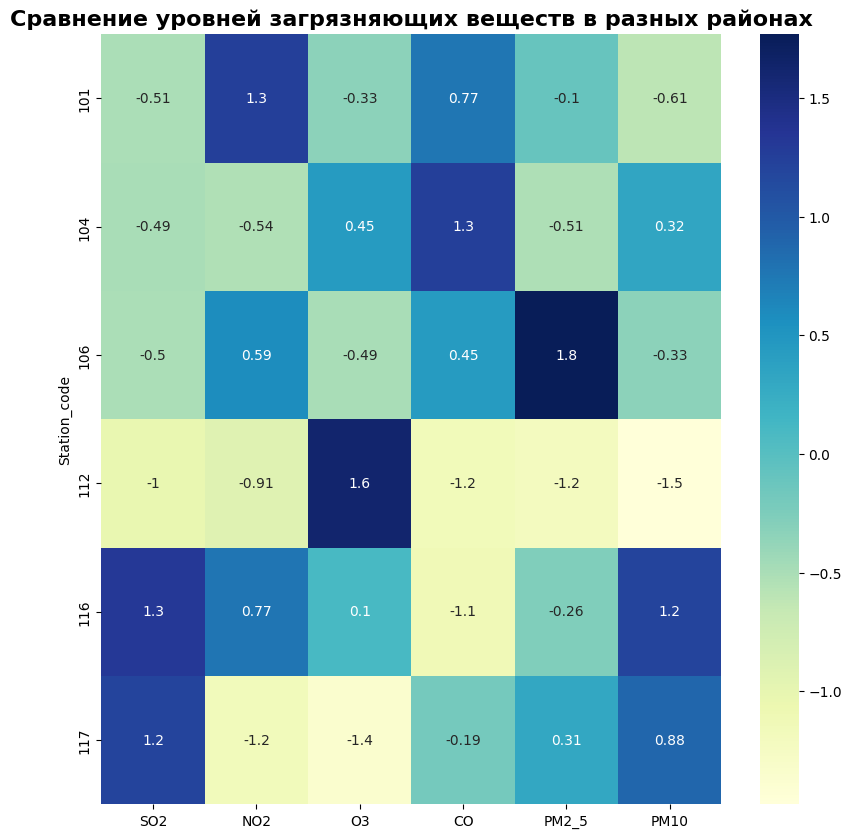

In [213]:
district_pol = eco.groupby(['Station_code']).mean().loc[:, 'SO2':'PM10']

district_pol_norm = (district_pol - district_pol.mean()) / district_pol.std()

district_pol_norm.columns = ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']

plt.figure(figsize=(10,10))
sns.heatmap(data=district_pol_norm, cmap="YlGnBu", annot=True)
plt.title('Сравнение уровней загрязняющих веществ в разных районах', fontsize=16, fontweight='bold')
plt.xticks(rotation=0);

Далее создадим интерактивные карты для визуализации концентраций различных загрязняющих веществ в районах Сеула.

In [215]:
district_names_to_display = full_data['District'].unique()

filtered_geojson = {
    "type": "FeatureCollection",
    "features": []
}

for feature in district_borders['features']:
    district_name = feature['properties']['SIG_ENG_NM']
    if district_name in district_names_to_display:
        filtered_geojson['features'].append(feature)

for col in ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']:
    pollutant_map = folium.Map(location=[37.562600, 127.024612], tiles='cartodb positron', zoom_start=11)

    for idx, row in full_data.iterrows():
        popup_content = f"Station_code: {row['Station_code']}<br>District: {row['District']}"
        Marker([row['Latitude'], row['Longitude']], popup=popup_content).add_to(pollutant_map)

    district_pol_norm_merged = district_pol_norm.merge(
        full_data[['Station_code', 'District']], 
        on='Station_code',
        how='left'
    )

    if 'District_x' in district_pol_norm_merged.columns:
        district_pol_norm_merged.rename(columns={'District_x': 'District'}, inplace=True)
    if 'District_y' in district_pol_norm_merged.columns:
        district_pol_norm_merged.drop(columns=['District_y'], inplace=True)

    district_pol_norm_merged = district_pol_norm_merged[district_pol_norm_merged['District'].isin(district_names_to_display)]

    Choropleth(
        geo_data=filtered_geojson,
        data=district_pol_norm_merged,
        columns=['District', col],
        key_on="feature.properties.SIG_ENG_NM",
        fill_color='YlGnBu',
        fill_opacity=0.7,
        line_opacity=0.2,
        legend_name=f'Concentration of {col} in Seoul (Z-score)'
    ).add_to(pollutant_map)

    display(Markdown(f'<center><h3>{col}</h3></center>'))
    display(pollutant_map)

<center><h3>SO2</h3></center>

<center><h3>NO2</h3></center>

<center><h3>O3</h3></center>

<center><h3>CO</h3></center>

<center><h3>PM2_5</h3></center>

<center><h3>PM10</h3></center>

Вычислим среднее значение Z-оценки с предыдущей тепловой карты и получим одно значение, которое представляет собой общую степень загрязнения воздуха в каждом районе. Ниже приведена соответствующая интерактивная карта.

In [218]:
district_names_to_display = full_data['District'].unique()

filtered_geojson = {
    "type": "FeatureCollection",
    "features": []
}

for feature in district_borders['features']:
    district_name = feature['properties']['SIG_ENG_NM']
    if district_name in district_names_to_display:
        filtered_geojson['features'].append(feature)

district_pol_norm['Avg_Z_Score'] = district_pol_norm[['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']].mean(axis=1)

district_pol_norm_merged = district_pol_norm.merge(
    full_data[['Station_code', 'District']], 
    on='Station_code',
    how='left'
)

if 'District_x' in district_pol_norm_merged.columns:
    district_pol_norm_merged.rename(columns={'District_x': 'District'}, inplace=True)
if 'District_y' in district_pol_norm_merged.columns:
    district_pol_norm_merged.drop(columns=['District_y'], inplace=True)

district_pol_norm_merged = district_pol_norm_merged[district_pol_norm_merged['District'].isin(district_names_to_display)]

pollutant_map = folium.Map(location=[37.562600, 127.024612], tiles='cartodb positron', zoom_start=11)

for idx, row in full_data.iterrows():
    popup_content = f"Station_code: {row['Station_code']}<br>District: {row['District']}"
    Marker([row['Latitude'], row['Longitude']], popup=popup_content).add_to(pollutant_map)

colormap = linear.YlGnBu_09.scale(district_pol_norm_merged['Avg_Z_Score'].min(), district_pol_norm_merged['Avg_Z_Score'].max())

Choropleth(
    geo_data=filtered_geojson,
    data=district_pol_norm_merged,
    columns=['District', 'Avg_Z_Score'],
    key_on="feature.properties.SIG_ENG_NM",
    fill_color='YlGnBu',
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Average Z-score for Pollution in Seoul',
    nan_fill_opacity=0
).add_to(pollutant_map)

display(Markdown('<center><h3>Average Z-score for Pollution in Seoul</h3></center>'))
display(pollutant_map)

<center><h3>Average Z-score for Pollution in Seoul</h3></center>

Из полученных данных видно, что, действительно, близко расположенные станции (106 и 116; 101 и 104) имеют в среднем близкую степень загрязнения воздуха. 

Если смотреть на отдельные вещества, то для каждого загрязнителя картины отличаются - близкие концентрации могут быть как в соседних районах, так и в отдаленных друг от друга. Например, в близко расположенных районах Gangseo-gu (116) и Guro-gu (117) наблюдаются близкие концентрации PM10 и SO2, но при этом различные концентрации NO2 и O3.

### 7) Изменяется ли степень загрязнения атмосферы в зависимости от времени года, а если изменяется, то насколько существенно и в каких районах? Может ли качество модели быть улучшено, если ко входящим переменным добавить день или месяц наблюдения? Каким образом вы реализуете введение новой переменной в модель?

In [219]:
full_data.head()

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10,Address,Latitude,Longitude,District
0,2017-01-01,101,0.004,0.0560,0.002,1.0,69.0,85.0,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,Jongno-gu
1,2017-01-01,104,0.006,0.0420,0.007,0.7,45.0,70.0,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848,Eunpyeong-gu
2,2017-01-01,106,0.005,0.0550,0.003,1.1,67.5,78.0,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597,Mapo-gu
3,2017-01-01,112,0.005,0.0440,0.002,0.9,69.0,82.0,"49, Samyang-ro 139-gil, Gangbuk-gu, Seoul, Rep...",37.647930,127.011952,Gangbuk-gu
4,2017-01-01,116,0.006,0.0515,0.002,1.0,56.5,73.0,"71, Gangseo-ro 45da-gil, Gangseo-gu, Seoul, Re...",37.544640,126.835151,Gangseo-gu


Добавим в таблицу full_data столбец для времени года:

In [220]:
def get_season(month):
    if month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    elif month in [9, 10, 11]:
        return 'Autumn'
    else:
        return 'Winter'

In [221]:
full_data['Season'] = full_data['Measurement_date'].dt.month.apply(get_season)

In [222]:
full_data.head()

,Measurement_date,Station_code,SO2,NO2,O3,CO,PM2_5,PM10,Address,Latitude,Longitude,District,Season
0,2017-01-01,101,0.004,0.0560,0.002,1.0,69.0,85.0,"19, Jong-ro 35ga-gil, Jongno-gu, Seoul, Republ...",37.572016,127.005008,Jongno-gu,Winter
1,2017-01-01,104,0.006,0.0420,0.007,0.7,45.0,70.0,"215, Jinheung-ro, Eunpyeong-gu, Seoul, Republi...",37.609823,126.934848,Eunpyeong-gu,Winter
2,2017-01-01,106,0.005,0.0550,0.003,1.1,67.5,78.0,"10, Poeun-ro 6-gil, Mapo-gu, Seoul, Republic o...",37.555580,126.905597,Mapo-gu,Winter
3,2017-01-01,112,0.005,0.0440,0.002,0.9,69.0,82.0,"49, Samyang-ro 139-gil, Gangbuk-gu, Seoul, Rep...",37.647930,127.011952,Gangbuk-gu,Winter
4,2017-01-01,116,0.006,0.0515,0.002,1.0,56.5,73.0,"71, Gangseo-ro 45da-gil, Gangseo-gu, Seoul, Re...",37.544640,126.835151,Gangseo-gu,Winter


Далее вычислим средние значения загрязнителей для каждого сезона:

In [223]:
seasonal_avg_pollution = full_data.groupby('Season')[['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']].mean()

seasonal_avg_pollution

,SO2,NO2,O3,CO,PM2_5,PM10
Season,,,,,,
Autumn,0.004474,0.026371,0.020346,0.515009,17.859761,30.909208
Spring,0.005251,0.028900,0.034743,0.505100,28.384367,57.500911
Summer,0.004341,0.020756,0.030918,0.379891,18.404891,29.756341
Winter,0.004967,0.032118,0.014664,0.645817,29.432565,46.138987


Построим графики для каждого вида загрязнителя:

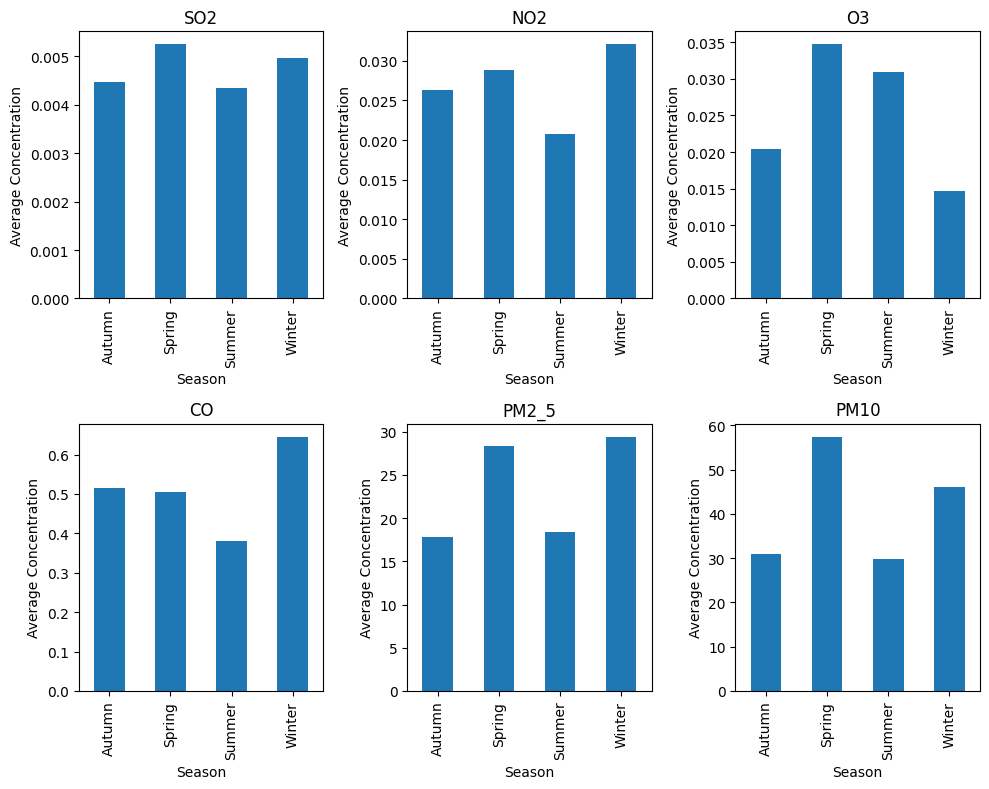

In [224]:
pollutants = ['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']

plt.figure(figsize=(10, 8))
for i, pollutant in enumerate(pollutants, 1):
    plt.subplot(2, 3, i)
    seasonal_avg_pollution[pollutant].plot(kind='bar', title=pollutant)
    plt.ylabel('Average Concentration')

plt.tight_layout();

Видно, что в среднем по всем районам концентрации SO2, NO2, PM2.5, PM10 выше весной и зимой. Концентрация O3 выше весной и летом, а для CO наблюдается повышение зимой.

Рассчитаем усредненные значения для каждого загрязнителя по району и сезону:

In [225]:
avg_pollution = full_data.groupby(['District', 'Season'])[['SO2', 'NO2', 'O3', 'CO', 'PM2_5', 'PM10']].mean().reset_index()

avg_pollution

,District,Season,SO2,NO2,O3,CO,PM2_5,PM10
0,Eunpyeong-gu,Autumn,0.004929,0.025143,0.023302,0.638462,16.236264,29.780220
1,Eunpyeong-gu,Spring,0.004156,0.027300,0.035467,0.559444,27.183333,61.638889
2,Eunpyeong-gu,Summer,0.003446,0.019228,0.031087,0.343478,19.016304,31.391304
3,Eunpyeong-gu,Winter,0.004202,0.027067,0.015983,0.729775,27.488764,46.269663
4,Gangbuk-gu,Autumn,0.003050,0.022094,0.023978,0.414444,15.027778,27.655556
5,Gangbuk-gu,Spring,0.003897,0.023750,0.040505,0.469565,24.880435,47.864130
6,Gangbuk-gu,Summer,0.002946,0.016674,0.034582,0.342391,16.418478,25.271739
7,Gangbuk-gu,Winter,0.004256,0.029750,0.019272,0.606111,27.916667,43.344444
8,Gangseo-gu,Autumn,0.005294,0.031306,0.016744,0.513333,19.744444,36.222222
9,Gangseo-gu,Spring,0.007386,0.032299,0.037212,0.425000,27.124813,64.347826


Получим визуализацию распределения загрязнителей по сезонам и районам.

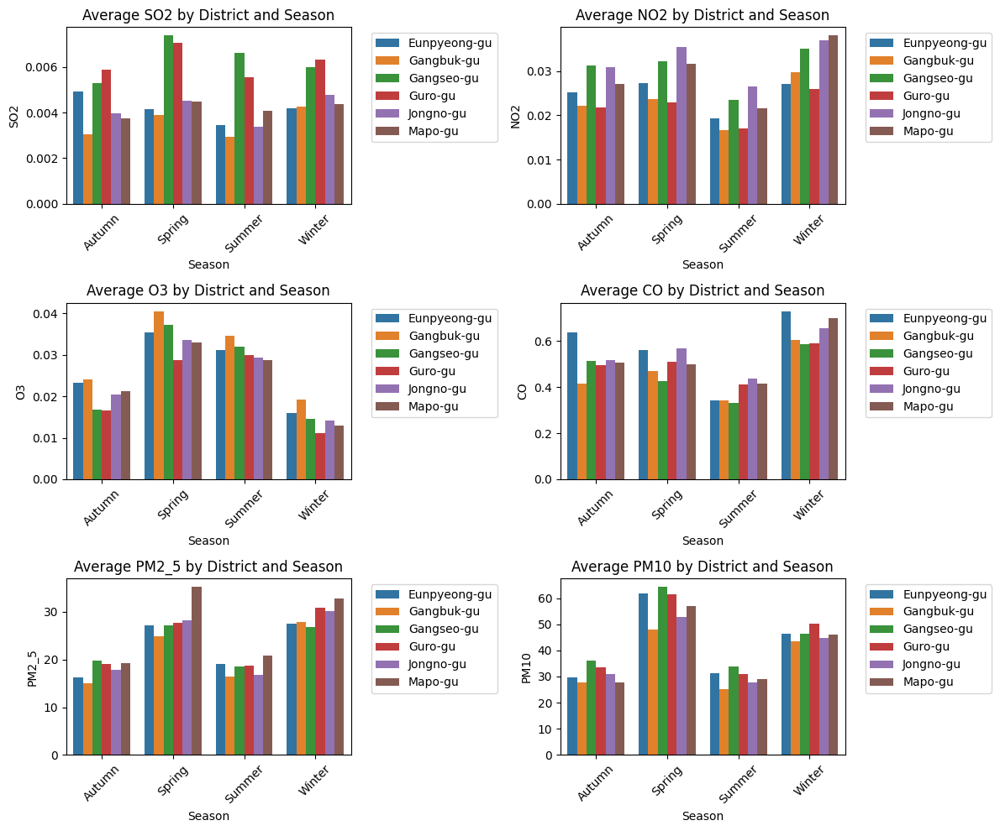

In [228]:
plt.figure(figsize=(12, 10))

for i, pollutant in enumerate(pollutants):
    plt.subplot(3, 2, i + 1)
    sns.barplot(data=avg_pollution, x='Season', y=pollutant, hue='District')
    plt.title(f'Average {pollutant} by District and Season')
    plt.xticks(rotation=45)
    plt.tight_layout()

    plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left');


Нормализуем данные о загрязнении, а затем агрегируем их, чтобы понять, как общий уровень загрязнения изменяется по районам и сезонам.

In [229]:
full_data_norm = full_data.copy()

scaler = StandardScaler()

full_data_norm[pollutants] = scaler.fit_transform(full_data_norm[pollutants])

full_data_norm['average_pollution'] = full_data_norm[pollutants].mean(axis=1)

avg_pollution_by_season = full_data_norm.groupby(['District', 'Season'])['average_pollution'].mean().reset_index()

avg_pollution_by_season

,District,Season,average_pollution
0,Eunpyeong-gu,Autumn,-0.080440
1,Eunpyeong-gu,Spring,0.285509
2,Eunpyeong-gu,Summer,-0.427754
3,Eunpyeong-gu,Winter,0.104297
4,Gangbuk-gu,Autumn,-0.525709
5,Gangbuk-gu,Spring,0.073582
6,Gangbuk-gu,Summer,-0.545338
7,Gangbuk-gu,Winter,0.062381
8,Gangseo-gu,Autumn,-0.059915
9,Gangseo-gu,Spring,0.610926


Визуализируем полученные данные:

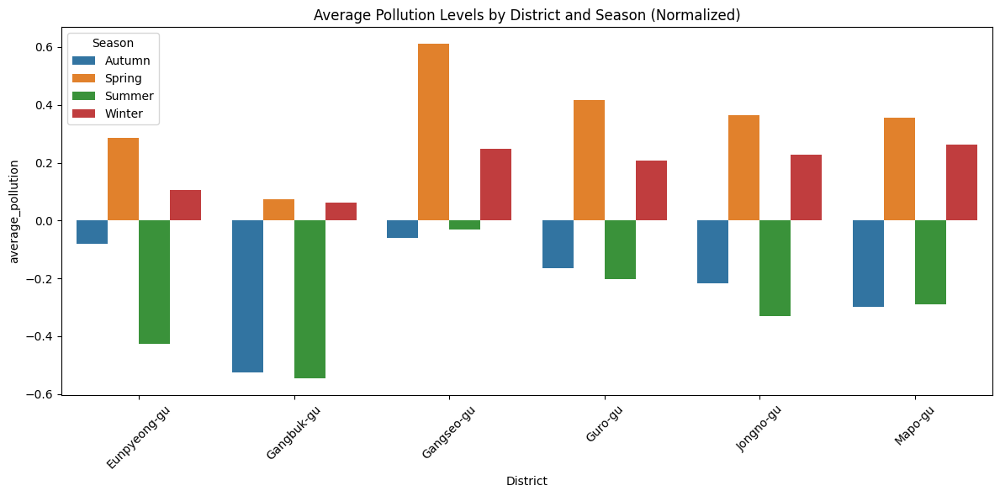

In [230]:
plt.figure(figsize=(12, 6))
sns.barplot(data=avg_pollution_by_season, x='District', y='average_pollution', hue='Season')
plt.xticks(rotation=45)
plt.title('Average Pollution Levels by District and Season (Normalized)')
plt.tight_layout();

Также посмотрим, как меняется общий уровень загрязнения по сезонам, без учета районов:

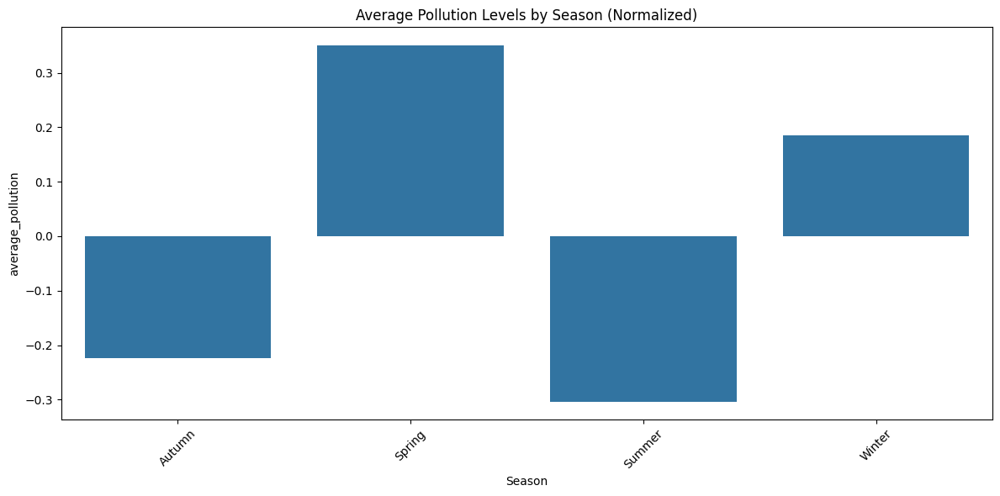

In [232]:
plt.figure(figsize=(12, 6))

avg_pollution_by_season_all = avg_pollution_by_season.groupby('Season')['average_pollution'].mean().reset_index()

sns.barplot(data=avg_pollution_by_season_all, x='Season', y='average_pollution')

plt.xticks(rotation=45)
plt.title('Average Pollution Levels by Season (Normalized)')
plt.tight_layout();

Таким образом, отвечая на вопрос об изменении степени загрязнения атмосферы в зависимости от времени года, можно отметить следующее:

1. Степень загрязнения воздуха в Сеуле действительно меняется в зависимости от сезона - наибольшая концентрация загрязняющих веществ в атмосфере наблюдается весной и зимой.

2. Для большинства районов разница в загрязнении между сезонами значительно варьируется, что свидетельствует о том, что загрязнение действительно изменяется в зависимости от времени года.

    - В некоторых районах, таких как Eunpyeong-gu и Gangseo-gu, разница между сезонами значительно высока (например, в Gangseo-gu, разница между весной и летом составляет 0.670841, а между летом и осенью -0.641065).
    
    - В других районах, таких как Mapo-gu, разница также заметна, хотя и не такая резкая. Например, в Mapo-gu разница между весной и осенью составляет 0.653105, между летом и осенью -0.645319.

Переходя ко второй части вопроса - добавление переменных, таких как день или месяц наблюдения, может улучшить качество модели, особенно учитывая, что наши данные имеют явные сезонные зависимости.

Загрязнение воздуха часто зависит от времени года (например, зимние месяцы могут быть более загрязнены из-за отопительного сезона), а также от дней недели (загрязнение может быть выше в будние дни из-за активности транспорта). Добавление признаков, таких как день или месяц, может помочь модели учесть эти тренды.

Если модель обучена без учёта временных факторов, она может не захватывать сезонные или месячные колебания загрязнения. Включение времени может дать модели дополнительные информацию о цикличности, помогая ей точнее прогнозировать загрязнение в разные периоды.

Дни и месяцы могут также быть связаны с другими внешними факторами, такими как праздники, климатические условия (например, жаркие летние дни) и изменения в транспортной активности. Эти факторы могут влиять на загрязнение, и модель будет лучше их учитывать, если будет знать дату.

В нашей задаче для введения новых переменных в модель можно использовать либо категориальные переменные, либо dummy-переменные (one-hot encoding) (второй вариант предпочтительнее).

Рассмотрим оба варианта.

1. Категориальные переменные

Использование категориальных переменных может быть полезным, если есть естественный порядок для временных признаков. Например, месяцы имеют естественный порядок (январь → февраль → март → и так далее), и день недели тоже может быть важен (понедельник → вторник → … → воскресенье). В этом случае можно преобразовать месяц и день недели в числовые значения.

Преимущества метода:
- Логика порядка: Если существует естественный порядок (например, месяцы или дни недели), модель будет воспринимать эту информацию;
- Меньше признаков: Преобразование в категориальные переменные сохранит меньше столбцов, по сравнению с one-hot encoding.

In [237]:
full_data['Month'] = full_data['Measurement_date'].dt.month
full_data['Day_of_week'] = full_data['Measurement_date'].dt.weekday

2. Dummy-переменные (One-hot encoding)

В нашем случае использование dummy-переменных будет более подходящим, чтобы модель учитывала каждый месяц или день недели как отдельную категорию без предположений о порядке. Месяцы не обязательно имеют линейную зависимость от загрязнения, и каждый месяц будет важен как отдельная категория.

Преимущества метода:
- Отсутствие предположений о порядке: Не предполагаем, что месяцы или дни недели имеют порядок;
- Гибкость: Модель может изучить различные эффекты для каждого месяца или дня недели;
- Для категорий без порядка: Это идеальный выбор, если нет очевидного порядка (например, если загрязнение в июле отличается от загрязнения в августе, и эта разница не линейная).

In [238]:
full_data = pd.get_dummies(full_data, columns=['Month', 'Day_of_week'], drop_first=True)

Таким образом, в случае нашей конкретной задачи dummy-переменные (one-hot encoding) для месяца и дня недели лучше, так как они позволят модели учитывать различия между месяцами и днями без предположений о порядке. В нашем случае загрязнение может сильно различаться между разными месяцами и one-hot encoding позволит модели изучить каждый месяц или день недели как отдельную категорию.